In [1]:
# Bioinformatics
import pysam
from pysam import VariantFile

# Data Analysis
import pandas as pd
import numpy as np
import math
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import Normalizer

# General
import sys
import os
import re

# Plotting libraries
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

mpl.rcParams['figure.dpi'] = 300
#plt.rc('text', usetex=True)

In [2]:
conditions_colors = {
    "30H": (0.0,0.0,1.0,0.8), # blue
    "30H_del": (0.0,0.7,1.0,0.25), # turquoise
    "30D": (1.0,0.5,0.0,0.8), # orangered
    "30D_del": (1.0,0.75,0.0,0.25), # orange
    "0Gy": (0.5,0.5,0.5,0.8), # dark grey
    "0Gy_del": (0.7,0.7,0.7,0.25), # lighter grey
    "100Gy": (0.7,0.0,0.6,0.8), # purple
    "100Gy_del": (1.0,0.0,0.8,0.25), # pinkish
    "250Gy": (0.0,0.75,0.0,0.8), # darkgreen
    "250Gy_del": (0.0,1.0,0.0,0.25), # limegreen
    "500Gy": (1.0,0.0,0.0,0.8), # red
    "500Gy_del": (1.0,0.5,0.5,0.25), # pink
    "H": (0.0,0.0,1.0,0.8),
    "H_del": (0.0,0.7,1.0,0.25),
    "D": (1.0,0.25,0.0,0.8),
    "D_del": (1.0,0.75,0.0,0.25),
}

conditions_cmap = {
    "30H":plt.cm.Blues,
    "30D":plt.cm.Oranges,
    "0Gy":plt.cm.Greys,
    "100Gy":plt.cm.Purples,
    "250Gy":plt.cm.Greens,
    "500Gy":plt.cm.Reds,
    "H":plt.cm.Blues,
    "D":plt.cm.Oranges,
}

conditions_names = {
    "30H": "GR Hydrated",
    "30D": "GR Desiccated",
    "0Gy": "GR 0Gy IR",
    "100Gy": "GR 100Gy IR",
    "250Gy": "GR 250Gy IR",
    "500Gy": "GR 500Gy IR",
    "H": "MA Hydrated",
    "D": "MA Desiccated"
}

conditions_shape = {
    "30H": "o",
    "30D": "o",
    "0Gy": "o",
    "100Gy": "o",
    "250Gy": "o",
    "500Gy": "o",
    "H": "d",
    "D": "d"
}

# COVERAGE
median_coverage = {
    "ancestor": 341,
    "H5A2": 54,
    "H5A2_50G": 63,
    "H5C2": 148,
    "P500_C18_E3":291,
}

col_MA = (55/255, 126/255, 184/255)
col_ARC = (255/255, 127/255, 0/255)
col_TE = (152/255, 78/255, 163/255, 0.65)

# LENGTHS OF CHROMOSOMES
reference = "/media/urbe/MyADrive1/Antoine/19-11-21_VariantCalling_ARC/input/reference.fa"
fai = "/media/urbe/MyADrive1/Antoine/19-11-21_VariantCalling_ARC/input/reference.fa.fai"
lengths = {}
for line in open(fai, 'r') :
    s = line.strip().split()
    lengths[s[0]] = int(s[1])

# TELOMERES
telomeres = {
    "Chrom_1":([0,1500000], [11000000, 18146847]),
    "Chrom_2":([0,2000000], [15000000, 16274841]),
    "Chrom_3":([0,4000000], [13500000, 20354777]),
    "Chrom_4":([0,1000000], [14000000, 15224634]),
    "Chrom_5":([0,5000000], [15500000, 16930519]),
    "Chrom_6":([0,2000000], [12000000, 13893210]),
}

# POSITIONS OF GENES, CDS AND REPEATS 
genes = "/media/urbe/MyADrive1/Antoine/19-11-21_VariantCalling_ARC/input/Avaga.genes.bed"
cds = "/media/urbe/MyADrive1/Antoine/19-11-21_VariantCalling_ARC/input/Avaga.CDS.bed"
repeats = "/media/urbe/MyADrive1/Antoine/19-11-21_VariantCalling_ARC/input/avaga.TEannotation.26-02-20.defragmentedDraftAnnot.bed"

# REPEATS DATAFRAME
reps = {"CHR":[], "START":[], "END":[]}
for line in open(repeats, "r") :
    s = line.strip().split("\t")
    reps["CHR"].append(s[0])
    reps["START"].append(int(s[1]))
    reps["END"].append(int(s[2]))
    
repdf = pd.DataFrame().from_dict(reps)

In [3]:
ccycle = list(plt.rcParams['axes.prop_cycle'].by_key()['color'])

colors = {
    "DEL":ccycle[3], # Heterozygous deletion
    "DUP":ccycle[2], # Duplication
    "LOH":ccycle[9], # LOH
    "RES":ccycle[8], # Restoration (cov = 1 previously 0.5)
    "HDE":ccycle[5], # Homozygous deletion
    "ancestor":ccycle[0],
    "midpoint":ccycle[2],
    "endpoint":ccycle[1], # and "offspring" for ARC
    "nanopore":ccycle[3],
}

In [4]:
# COVERAGE
median_coverage = {
    "ancestor": 341,
    "D2A1": 47,
    "D2B3": 264, # has a 50G
    "D2B3_50G": 408,
    "D2C1": 110, # has a 50G
    "D2C1_50G": 137,
    "D2C3": 106, # has a 50G
    "D2C3_50G": 118,
    "D3A1": 49,
    "D3A3": 105,  # has a 50G
    "D3A3_50G": 177,
    "D4A3": 54,
    "D4B4": 144, # has a 50G
    "D4B4_50G":176,
    "D5B3": 73,
    "D5C1": 120, # has a 50G
    "D5C1_50G": 127,
    "D5C3": 156, # has a 50G
    "D5C3_50G": 194,
    "H2A3": 449,
    "H2B4": 122, # has a 50G
    "H2B4_50G": 27, # LOW COVERAGE SAMPLE
    "H2C3": 148,
    "H3A4": 90, # has a 50G
    "H3A4_50G": 150,
    "H3C4": 127, # has a 50G
    "H3C4_50G": 111,
    "H4A4": 409, # has a 50G
    "H4A4_50G": 404,
    "H4C2": 204,
    "H5A2": 54, # has a 50G
    "H5A2_50G": 63,
    "H5A3": 202,
    "H5A4": 126, # has a 50G
    "H5A4_50G": 131,
    "H5C2": 148, # has a 50G
    "H5C2_50G": 165,
    
    "30H_C3_E4":  199,
    "30H_C3_E5":  209,
    "30H_C36_E5": 244,
    "30H_C48_E5": 275,
    
    "30D_C13_E3": 259,
    "30D_C38_E4": 193,
    "30D_C38_E5": 236,
    "30D_C52_E5": 208,
    
    "P0_C9_E4":   186,
    "P0_C9_E5":   174,
    "P0_C27_E5":  242,
    "P0_C40_E5":  192,
    
    "P100_C8_E3": 413,
    "P100_C8_E4": 431,
    "P100_C30_E3":424,
    "P100_C30_E4":490,
    
    "P250_C8_E3": 390,
    "P250_C8_E4": 334,
    "P250_C17_E3":354,
    "P250_C17_E4":435,
    
    "P500_C16_E4":185,
    "P500_C16_E5":187,
    "P500_C18_E3":291,
    "P500_C30_E3":275,
}

### LOH score and DeltaCov variation examples

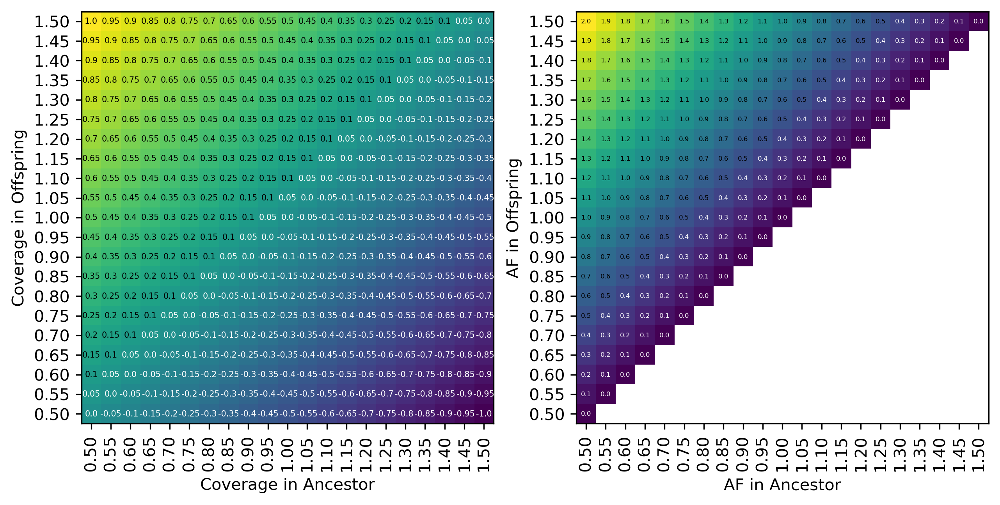

In [5]:
AF = np.arange(0.5, 1.501, 0.05)
COV = np.arange(0.5, 1.501, 0.05)

def get_LOH_score(anc_AF, off_AF) :
    delta = anc_AF - off_AF
    return 2*abs(delta) # 1.0 = LOH, 0.0 = no changes

def get_COV_score(anc_COV, off_COV) :
    return off_COV - anc_COV

LS = np.zeros((len(AF), len(AF)))
for i, x in enumerate(AF) :
    for j, y in enumerate(AF[::-1]) :
        
        if y < x :
            LS[i,j] = None
            continue
        
        LS[i,j] = get_LOH_score(x, y)

dC = np.zeros((len(COV), len(COV)))
for i, x in enumerate(COV) :
    for j, y in enumerate(COV[::-1]) :
        dC[i,j] = get_COV_score(x, y)


fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10,7))

ax=axs[0]
ax.imshow(dC)

ticks = np.arange(0, len(COV))
ax.set_xticks(ticks)
ax.set_xticklabels(["{:.2f}".format(t) for t in COV], rotation=90)
ax.set_yticks(ticks)
ax.set_yticklabels(["{:.2f}".format(t) for t in COV[::-1]])

for i in range(len(COV)):
    for j in range(len(COV)):
        col = "w" if dC[i,j] < 0.1 else "k"
        text = ax.text(j, i, str(round(dC[i, j], 2)), ha="center", va="center", color=col, fontsize=5)

ax.set_ylabel("Coverage in Offspring")
ax.set_xlabel("Coverage in Ancestor")
        
ax=axs[1]
ax.imshow(LS)

ticks = np.arange(0, len(AF))
ax.set_xticks(ticks)
ax.set_xticklabels(["{:.2f}".format(t) for t in AF], rotation=90)
ax.set_yticks(ticks)
ax.set_yticklabels(["{:.2f}".format(t) for t in AF[::-1]])

for i in range(len(AF)):
    for j in range(len(AF)):
        col = "w" if LS[i,j] < 0.5 else "k"
        if np.isnan(LS[i,j]) :
            continue
        text = ax.text(j, i, str(round(LS[i, j], 2)), ha="center", va="center", color=col, fontsize=4)

ax.set_ylabel("AF in Offspring")
ax.set_xlabel("AF in Ancestor")

fig.subplots_adjust(wspace=0.2)

plt.show()

### Coverage data

In [6]:
cov_data = {}

for sample in median_coverage.keys() :
    
    if sample.startswith("H") or sample.startswith("D") :
        covdir = "/media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/"
        covfile = os.path.join(covdir, sample + ".sorted.CALL.bam.cov.gz")
        if not os.path.isfile(covfile) :
            print("ERROR: could not find file: {}".format(covfile))
        
        mid_covfile = os.path.join(covdir, sample + "_50G" + ".sorted.CALL.bam.cov.gz")
        if os.path.isfile(mid_covfile) :
            cov_data[sample+"_50G"] = mid_covfile
        
    else :
        covdir = "/media/urbe/MyADrive1/Antoine/19-11-21_VariantCalling_ARC/coverage/"
        covfile = os.path.join(covdir, sample + ".sorted.CALL.bam.cov.gz")
        if not os.path.isfile(covfile) :
            print("ERROR: could not find file: {}".format(covfile))

    cov_data[sample] = covfile
for k, v in cov_data.items() :
    print(k, v)

ancestor /media/urbe/MyADrive1/Antoine/19-11-21_VariantCalling_ARC/coverage/ancestor.sorted.CALL.bam.cov.gz
D2A1 /media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/D2A1.sorted.CALL.bam.cov.gz
D2B3_50G /media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/D2B3_50G.sorted.CALL.bam.cov.gz
D2B3 /media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/D2B3.sorted.CALL.bam.cov.gz
D2C1_50G /media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/D2C1_50G.sorted.CALL.bam.cov.gz
D2C1 /media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/D2C1.sorted.CALL.bam.cov.gz
D2C3_50G /media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/D2C3_50G.sorted.CALL.bam.cov.gz
D2C3 /media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/D2C3.sorted.CALL.bam.cov.gz
D3A1 /media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/D3A1.sorted.CALL.bam.cov.gz
D3A3_50G /media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/coverage/D

In [7]:
def parse_vcf(vcf, ancestor, sample) :
    
    dc = {
        "CHROM":[], "POS":[], "QUAL":[], # general
        "ADP":[], "AAD":[], "AAF":[], # ancestor
        "ODP":[], "OAD":[], "OAF":[], # illumina offspring
    }
    
    # Parse variant file
    vcf_in = VariantFile(vcf)  # auto-detect input format
    vcf_in.subset_samples([ancestor, sample])
    
    # For record in sample
    for rec in vcf_in :
        
        dc["CHROM"].append(rec.chrom)
        dc["POS"].append(rec.pos)
        dc["QUAL"].append(rec.qual)
        
        try :
            dc["ADP"].append(rec.samples[ancestor]["DP"])
        except :
            dc["ADP"].append(None)
        try :
            dc["ODP"].append(rec.samples[sample]["DP"])
        except :
            dc["ODP"].append(None)
        
        try :
            dc["AAD"].append(rec.samples[ancestor]["AD"])
            try :
                dc["AAF"].append(max(rec.samples[ancestor]["AD"])/rec.samples[ancestor]["DP"])
            except :
                dc["AAF"].append(None)
        except :
            dc["AAD"].append(None)
            dc["AAF"].append(None)
        
        try :
            dc["OAD"].append(rec.samples[sample]["AD"])
            try :
                dc["OAF"].append(max(rec.samples[sample]["AD"])/rec.samples[sample]["DP"])
            except :
                dc["OAF"].append(None)
        except :
            dc["OAD"].append(None)
            dc["OAF"].append(None)
        
    vcf_in.close()
    df = pd.DataFrame.from_dict(dc)
    
    return df

In [8]:
vcf_ME = "/media/urbe/MyBDrive1/Antoine/27-10-21_VariantCalling_MA/genotype_allsamples/merged.only_het.gets.bcf"
vcf_GR = "/media/urbe/MyADrive1/Antoine/19-11-21_VariantCalling_ARC/jointgenotyping/merged.only_het.gets.bcf"

In [9]:
cov_anc = pd.read_csv(
    "/media/urbe/MyADrive1/Antoine/19-11-21_VariantCalling_ARC/coverage/ancestor.sorted.CALL.bam.cov.gz",
    sep="\t", compression="gzip", usecols=range(3), names=["ref", "pos", "cov"], header=None, skiprows=1,
)

cov_anc = cov_anc.rename(columns={"ref":"CHROM", "pos":"POS", "cov":"COV_ANC"})

In [14]:
def get_LOH_score(anc_AF, off_AF) :
    #delta = anc_AF["AF", "mean"] - off_AF["AF", "mean"]
    delta = anc_AF - off_AF
    return 2*abs(delta) # 1.0 = LOH, 0.0 = no changes

def get_COV_score(anc_COV, off_COV) :
    return off_COV - anc_COV

def get_sample_data(sample, control, cov_data, vcf, show_mid = True) :
    
    # Check if ME
    is_ME = True if (sample.startswith("H") or sample.startswith("D")) else False
    
    if is_ME :
        has_mid = False
        sample_mid = None
        try :
            sample_mid = sample+"_50G"
            cov_mid = pd.read_csv(
                cov_data[sample_mid], sep="\t", compression="gzip",
                usecols=range(3), names=["ref", "pos", "cov"],
                header=None, skiprows=1,
            )
            cov_mid = cov_mid.rename(columns={"ref":"CHROM", "pos":"POS", "cov":"COV_ILU"})
            df_mid = parse_vcf(vcf, "ancestor", sample_mid)
            has_mid = True
        except :
            has_mid = False
    else :
        has_mid = False
        
    cov_end = pd.read_csv(
        cov_data[sample], sep="\t", compression="gzip",
        usecols=range(3), names=["ref", "pos", "cov"],
        header=None, skiprows=1,
    )
    cov_end = cov_end.rename(columns={"ref":"CHROM", "pos":"POS", "cov":"COV_ILU"})
    df_end = parse_vcf(vcf, "ancestor", sample)

    cov_ctl = pd.read_csv(
        cov_data[control], sep="\t", compression="gzip",
        usecols=range(3), names=["ref", "pos", "cov"],
        header=None, skiprows=1,
    )
    cov_ctl = cov_ctl.rename(columns={"ref":"CHROM", "pos":"POS", "cov":"COV_ILU"})
    df_ctl = parse_vcf(vcf, "ancestor", control)

    if has_mid and show_mid :
        return df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid
    else :
        return df_end, cov_end, df_ctl, cov_ctl, None, None

def plot_region(
    sample, control, # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    chrom, start, end, # coordinates
    df_mid=None, cov_mid=None, # in case of midpoint sample
    win_cov=100, # smoothing for coverage
    cymin = -0.6, cymax = 0.6, # coverage ymin coverage ymax
    ls = None, le = None, # line starts and line ends
    cyticks=[-0.5, -0.25, 0.0, 0.25, 0.5],
    show_cov_scatter=False, add_vlines=False,
    show_mid = True, show_raw_cov = False, show_AF = False,
) :
    
    has_mid = True if df_mid is not None else False
    is_ME = True if (sample.startswith("H") or sample.startswith("D")) else False
    
    fig, axs = plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(4,3))
    
    flt_end = df_end.query("CHROM == @chrom & POS > @start & POS < @end & QUAL >= 1000")
    flt_ctl = df_ctl.query("CHROM == @chrom & POS > @start & POS < @end & QUAL >= 1000")
    if has_mid and show_mid :
        flt_mid = df_mid.query("CHROM == @chrom & POS > @start & POS < @end & QUAL >= 1000")
    
    fcv_anc = cov_anc.query("CHROM == @chrom & POS > @start & POS < @end")
    fcv_end = cov_end.query("CHROM == @chrom & POS > @start & POS < @end")
    fcv_ctl = cov_ctl.query("CHROM == @chrom & POS > @start & POS < @end")
    if has_mid and show_mid :
        fcv_mid = cov_mid.query("CHROM == @chrom & POS > @start & POS < @end")
        
    LOH_end = [get_LOH_score(x, y) for x, y in zip(flt_end["AAF"], flt_end["OAF"])]
    LOH_ctl = [get_LOH_score(x, y) for x, y in zip(flt_ctl["AAF"], flt_ctl["OAF"])]
    if has_mid :
        LOH_mid = [get_LOH_score(x, y) for x, y in zip(flt_mid["AAF"], flt_mid["OAF"])]
    
    # Plot LOH score scatter
    ax = axs[0]
    ax.scatter(flt_ctl["POS"], LOH_ctl, fc=colors["ancestor"]+"80", marker=".", s=6, lw=0.0, zorder=1, label=sample + " (control)")
    ax.scatter(flt_end["POS"], LOH_end, fc=colors["endpoint"]+"80", marker=".", s=6, lw=0.0, zorder=1, label=sample)
    if has_mid and show_mid :
        ax.scatter(flt_mid["POS"], LOH_mid, fc=colors["midpoint"]+"80", marker=".", s=6, lw=0.0, zorder=1, label=control + " (midpoint)")
    if show_AF :
        ax.scatter(flt_end["POS"], flt_end["AAF"], color="k", marker=".", s=3, lw=0.0, label="AF ancestor")
        ax.scatter(flt_end["POS"], flt_end["OAF"], color="r", marker=".", s=3, lw=0.0, label="AF endpoint")
        if has_mid and show_mid :
            ax.scatter(flt_mid["POS"], flt_mid["OAF"], color="g", marker=".", s=3, lw=0.0, label="AF midpoint")
    
    # Format plot
    xticks = np.arange(start, end+1, 1e3)
    ax.set_xticks(xticks)
    ticklabels = ["" for i in xticks]
    ax.set_xticklabels(ticklabels)
    ax.set_ylim(-0.1, 1.3)
    ax.set_ylabel("LOH score", fontsize=8)
    afticks = [0.0, 0.25,0.5,0.75,1.0]
    ax.set_yticks(afticks)
    ax.grid(axis='y', zorder=1, lw=0.5, color=[0.5,0.5,0.5])
    
    if ls is not None and le is not None :
        ax.plot([ls, le], [1.1, 1.1], color="k", lw=1.0, zorder=2)
        
        size = le-ls
        if size > 1000 :
            size = (le-ls)/1000
            ax.text(x=ls+((le-ls)/2), y=1.133, s="{:.2f}K".format(size), ha="center", va="bottom", fontsize=6)
        else :
            ax.text(x=ls+((le-ls)/2), y=1.133, s="{}bp".format(size), ha="center", va="bottom", fontsize=6)

    one_percent_length = (end-start)*0.01
    ax.set_xlim(start-2*one_percent_length, end+2*one_percent_length)
    
    ### Coverage ###
    ax = axs[1]
    
    merged_end = pd.merge(fcv_anc, fcv_end, on=["POS", "CHROM"])
    ADP = merged_end["COV_ANC"]/median_coverage["ancestor"]
    ADP_rol = ADP.rolling(window=win_cov).mean()
    EDP = merged_end["COV_ILU"]/median_coverage[sample]
    EDP_rol = EDP.rolling(window=win_cov).mean()
    dc_EDP = [get_COV_score(x, y) for x, y in zip(ADP_rol, EDP_rol)]
    
    merged_ctl = pd.merge(fcv_anc, fcv_ctl, on=["POS", "CHROM"])
    ADP = merged_ctl["COV_ANC"]/median_coverage["ancestor"]
    ADP_rol = ADP.rolling(window=win_cov).mean()
    CDP = merged_ctl["COV_ILU"]/median_coverage[control]
    CDP_rol = CDP.rolling(window=win_cov).mean()
    dc_CDP = [get_COV_score(x, y) for x, y in zip(ADP_rol, CDP_rol)]
    
    if has_mid and show_mid :
        merged_mid = pd.merge(fcv_anc, fcv_mid, on=["POS", "CHROM"])
        ADP = merged_mid["COV_ANC"]/median_coverage["ancestor"]
        ADP_rol = ADP.rolling(window=win_cov).mean()
        MDP = merged_mid["COV_ILU"]/median_coverage[sample+"_50G"]
        MDP_rol = MDP.rolling(window=win_cov).mean()
        dc_MDP = [get_COV_score(x, y) for x, y in zip(ADP_rol, MDP_rol)]
    
    
    ax.plot(merged_ctl["POS"], dc_CDP, color=colors["ancestor"]+"BF", lw=1.25, zorder=2, label=control + " (control)")
    ax.plot(merged_end["POS"], dc_EDP, color=colors["endpoint"]+"BF", lw=1.25, zorder=5, label=sample)
    if show_cov_scatter :
        dc_ctl_scat = [get_COV_score(x, y) for x, y in zip(ADP, CDP)]
        ax.scatter(merged_ctl["POS"], dc_ctl_scat, fc=colors["ancestor"]+"80", marker=".", s=6, lw=0.0, zorder=1)
        dc_end_scat = [get_COV_score(x, y) for x, y in zip(ADP, EDP)]
        ax.scatter(merged_end["POS"], dc_end_scat, fc=colors["endpoint"]+"80", marker=".", s=6, lw=0.0, zorder=1)
    
    if show_raw_cov :
        ax.plot(merged_end["POS"], ADP_rol, color="k", lw=0.5, zorder=2, label="Ancestor raw coverage")
        ax.plot(merged_end["POS"], EDP_rol, color="r", lw=0.5, zorder=2, label="Endpoint raw coverage")
        if has_mid and show_mid :
            ax.plot(merged_mid["POS"], MDP_rol, color="g", lw=0.5, zorder=2, label="Midpoint raw coverage")
    
    if has_mid and show_mid :
        ax.plot(merged_mid["POS"], dc_MDP, color=colors["midpoint"]+"BF", lw=1.25, zorder=3, label=sample + " (midpoint)")
        if show_cov_scatter :
            dc_mid_scat = [get_COV_score(x, y) for x, y in zip(ADP, MDP)]
            ax.scatter(merged_mid["POS"], dc_mid_scat, fc=colors["midpoint"]+"80", marker=".", s=6, lw=0.0, zorder=1)

    ax.yaxis.grid(True, zorder=1)
    ax.set_ylim(cymin, cymax)
    ax.set_yticks(cyticks)
    ax.tick_params(labelsize=8)
    
    if win_cov >= 1000 :
        rol_av = "Rolling window: {:.1f}Kb".format(win_cov/1000)
    else :
        rol_av = "Rolling window: {}bp".format(win_cov)
    ax.set_ylabel(r"$\Delta$ Coverage", fontsize=8)
    
    xp = start # start + 1% of region size
    yp = max(cyticks)-0.02
    ax.text(x=xp, y=yp, s=rol_av, ha="left", va="top", fontsize=5)

    start = min(merged_end["POS"])
    end = max(merged_end["POS"])
    ticks = np.linspace(start, end, 10)
    ticklabels = []
    for t in ticks :
        ticklabels.append("{:.3f}M".format(t/1e6))
    ax.set_xticks(ticks)
    ax.set_xticklabels(ticklabels, fontsize=6, rotation=45) #, fontsize=12)
    ax.set_xlabel("{}".format(chrom), fontsize=8)
    
    for pi, ax in enumerate(axs) :
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.grid(axis='y', zorder=1, lw=0.5, color=[0.5,0.5,0.5])
        ax.tick_params(axis="y", length=0.5)
        ax.tick_params(labelsize=6)
        
        if add_vlines :
            if pi == 0 :
                ax.vlines(x=[ls, le], ymin=-0.1, ymax=1.0, color="k", linestyle="dashed", lw=0.75, zorder=15)
            else :
                ax.vlines(x=[ls, le], ymin=cymin, ymax=cymax, color="k", linestyle="dashed", lw=0.75, zorder=15)

    plt.subplots_adjust(hspace=0.03)
    
    lgd = ax.legend(loc="lower right", ncol=3, fontsize=5, frameon=True, framealpha=1.0, facecolor="white")
    lgd.get_frame().set_alpha(None)
    lgd.get_frame().set_facecolor((1, 1, 1, 1))
    lgd.set_zorder(25)
    
    plt.show()

# H2B4

In [15]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("H2B4", "H5C2", cov_data, vcf_ME, show_mid = False)

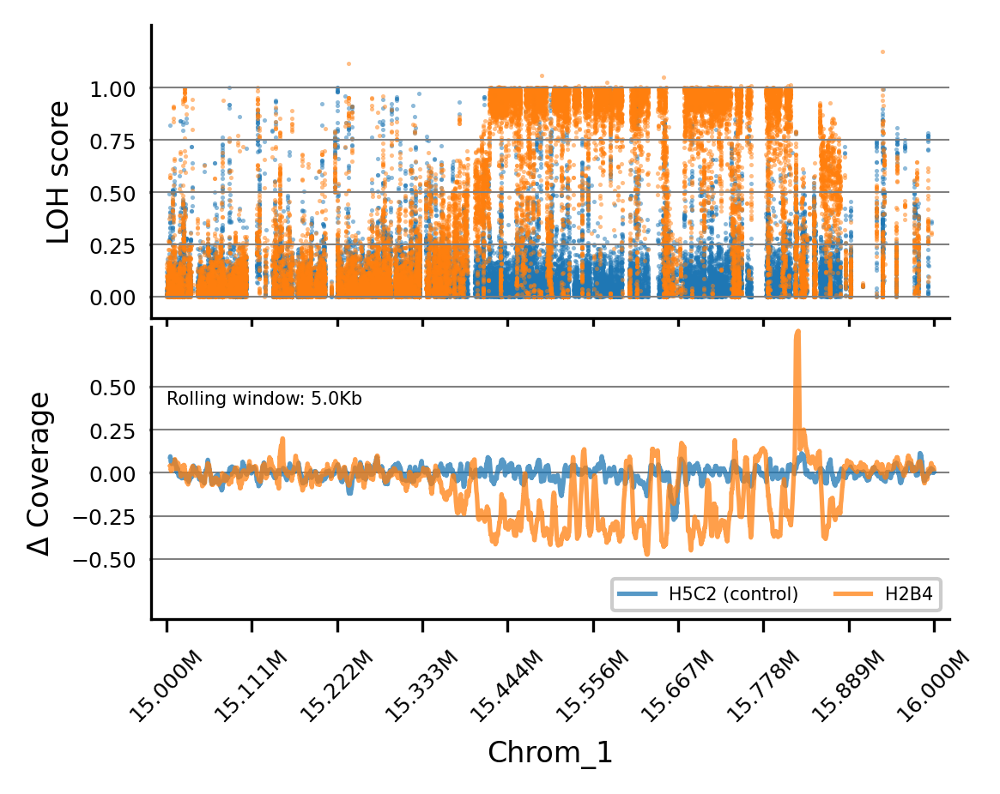

In [16]:
plot_region(
    "H2B4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 15000000, 16000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -0.85, cymax = 0.85, # coverage ymin coverage ymax
    show_mid = False,
    #ls = 18750000, le = 18850000, # line starts and line ends, yl= line y value
)

**The following region has first a drop of 25% then a drop of 50%, given the LOH score at .5 then at .1, I suppose this means that a collapsed duplicated region was present in ancestor and 1 copy was lost:**

```
Reference:
0: -A-A-A-
Actual haplotypes in ancestor:
1: -A-A-A-
2: -B-B-B- AF = 0.5 COV = 1.0
Haplotypes after deletion in offspring:
1: -A-
2: -B-B-B-
=> AF = 0.75 (3/4) -> LOH score = 0.25
=> COV = 0.66 (4/6) -> DeltaCov = -0.33
```

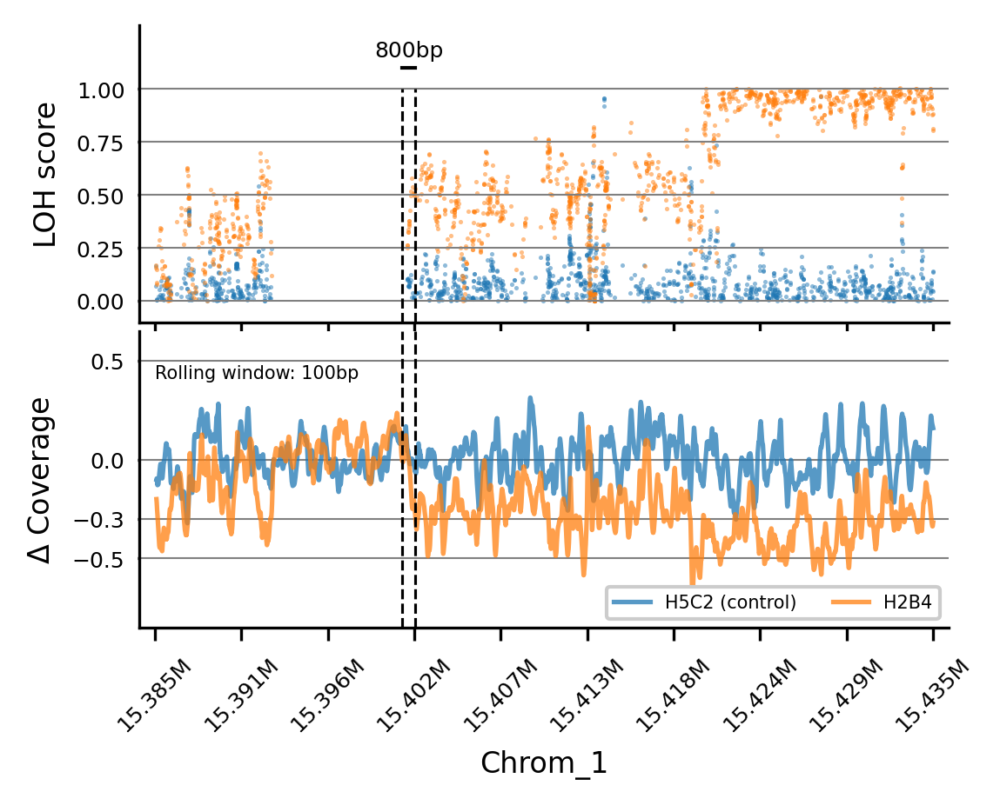

In [17]:
plot_region(
    "H2B4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 15385000, 15435000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=100, # smoothing for coverage
    cymin = -0.85, cymax = 0.65, # coverage ymin coverage ymax
    cyticks=[-0.5, -0.3, 0.0, 0.5],
    show_mid = False, show_AF = False, show_raw_cov = False,
    ls = 15400900, le = 15401700, # line starts and line ends, yl= line y value
    add_vlines = True,
)

**The following one has interspersed deletions in the offspring, probably because LOH homozygotised some hemizygous deletions but the tip of the deletion has been lost: probably a homozygous deletion due to chromosome size difference in ancestor**

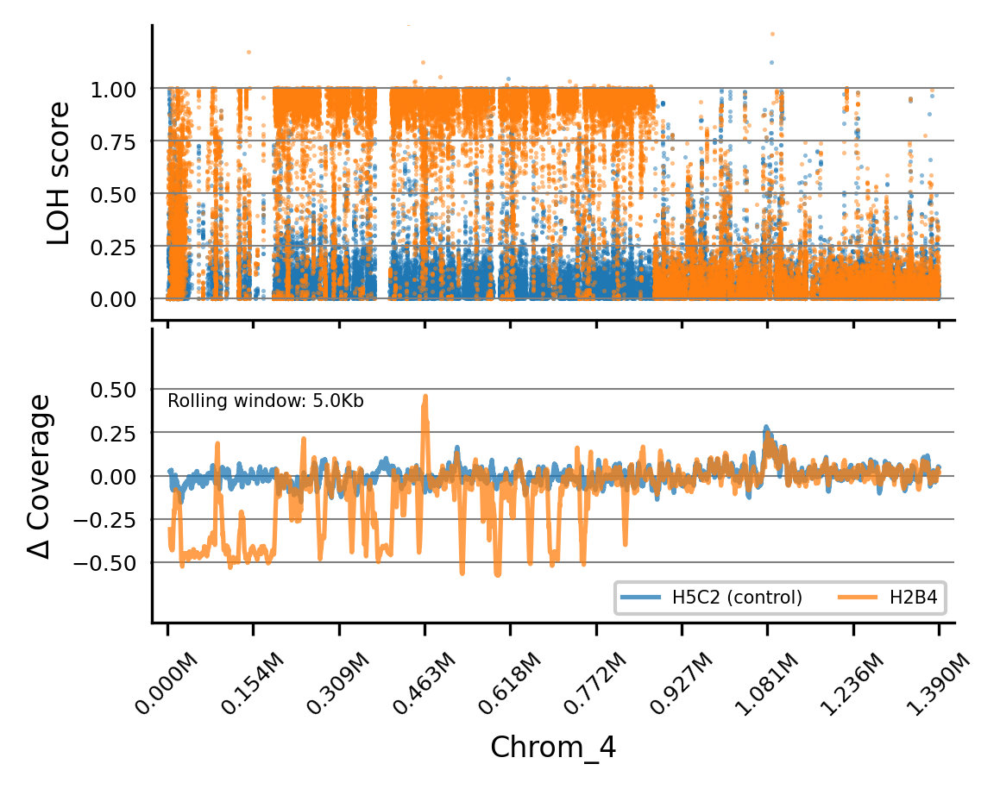

In [18]:
plot_region(
    "H2B4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 0, 1390000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -0.85, cymax = 0.85, # coverage ymin coverage ymax
    #ls = 18750000, le = 18850000, # line starts and line ends, yl= line y value
)

**Zooming on the homozygous deletion at the tip ~0.192M**

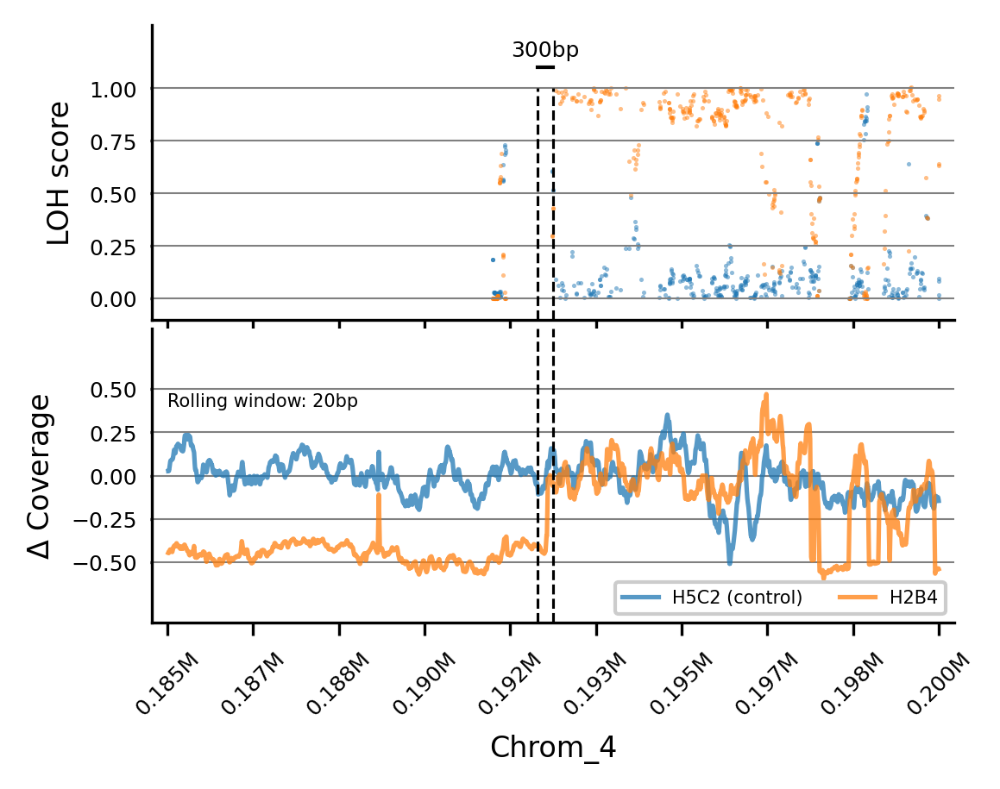

In [19]:
plot_region(
    "H2B4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 185000, 200000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -0.85, cymax = 0.85, # coverage ymin coverage ymax
    ls = 192200, le = 192500, # line starts and line ends, yl= line y value
    add_vlines = True,
)

**Zooming on a deletion within the region (635K > 665K)**

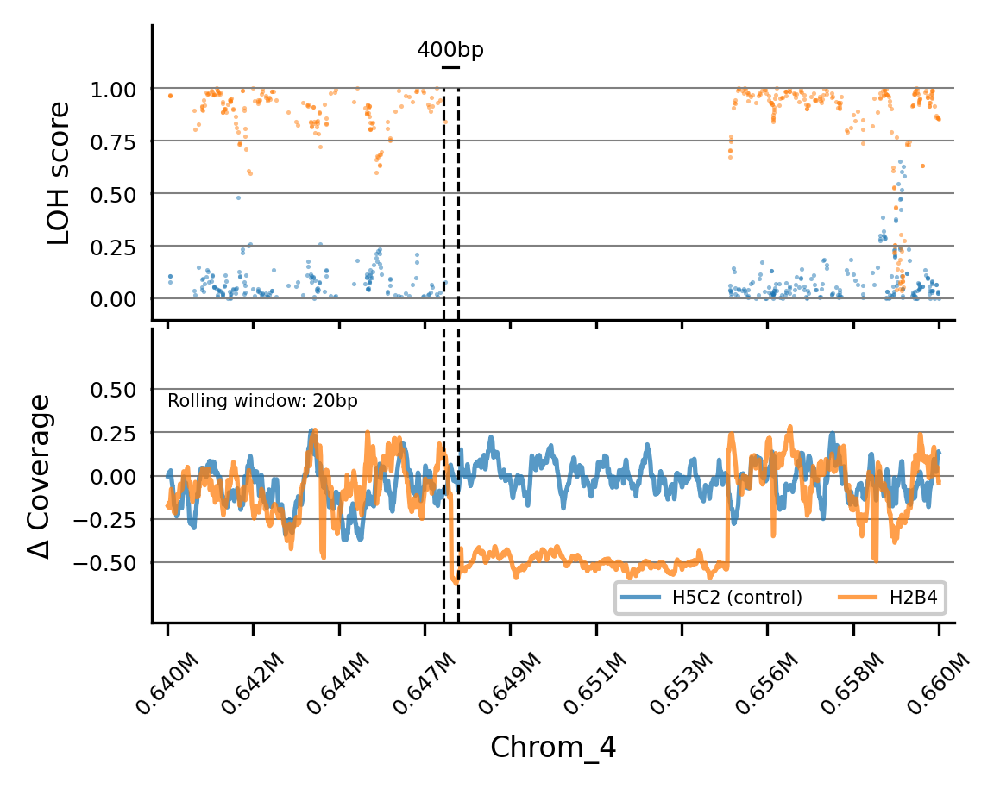

In [20]:
plot_region(
    "H2B4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 640000, 660000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -0.85, cymax = 0.85, # coverage ymin coverage ymax
    ls = 647150, le = 647550, # line starts and line ends, yl= line y value
    add_vlines = True,
)

# H3A4

In [21]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("H3A4", "H5C2", cov_data, vcf_ME)

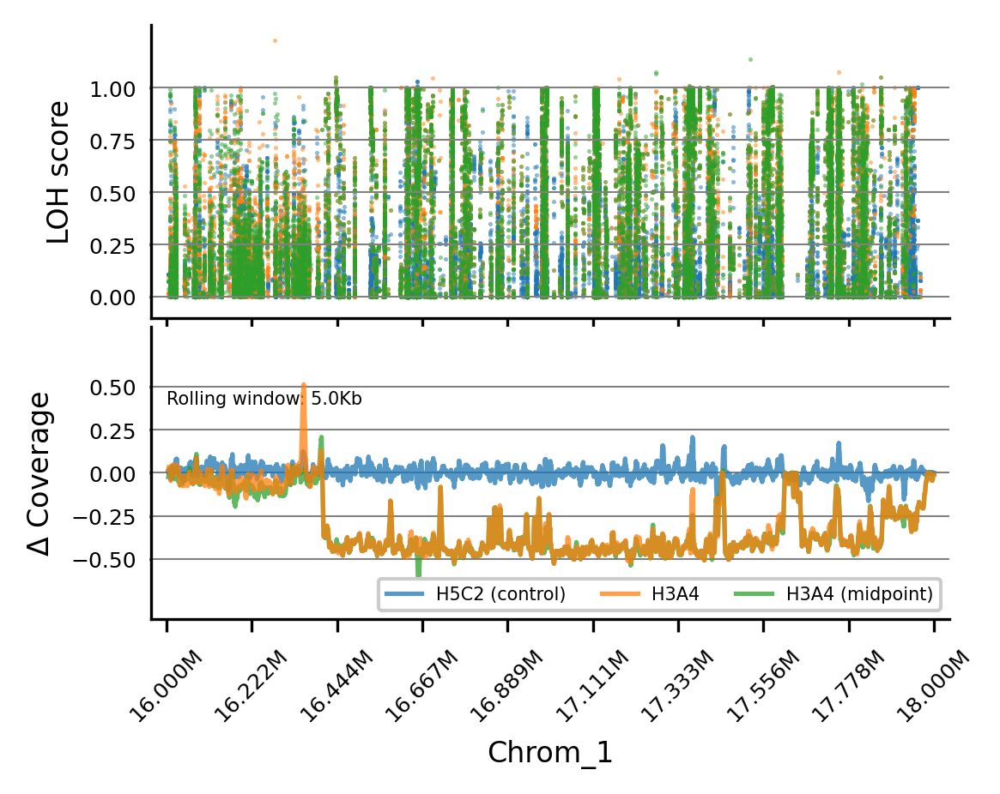

In [22]:
plot_region(
    "H3A4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 16000000, 18000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -0.85, cymax = 0.85, # coverage ymin coverage ymax
    #ls = 18750000, le = 18850000, # line starts and line ends, yl= line y value
)

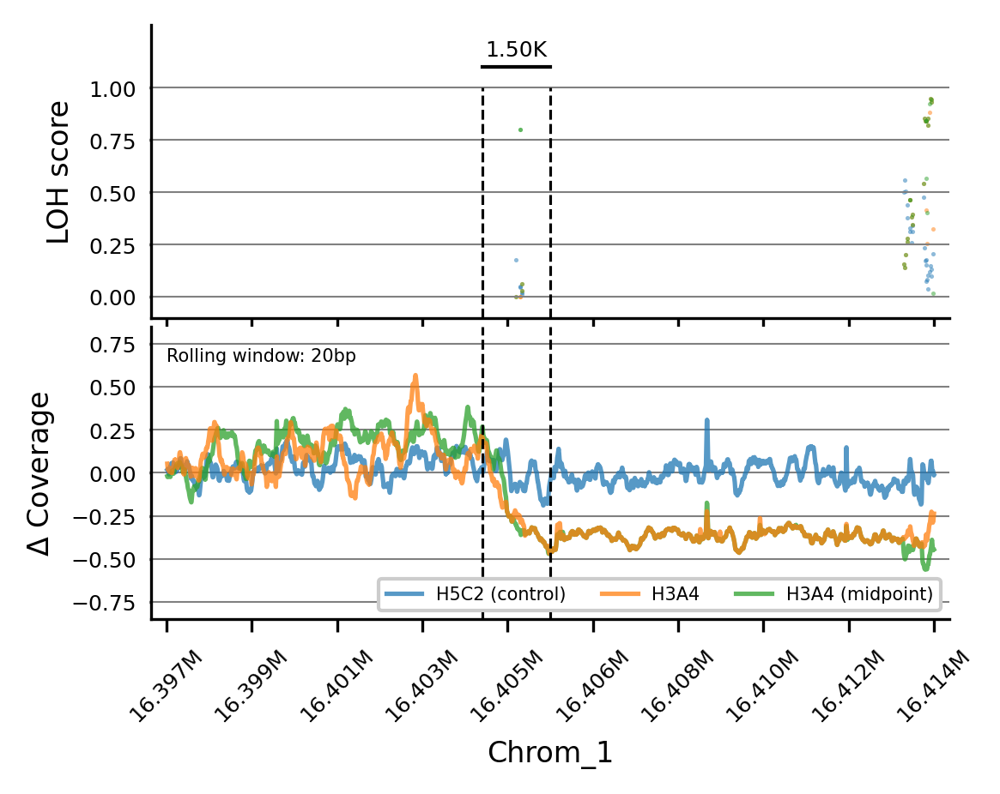

In [23]:
plot_region(
    "H3A4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 16397000, 16414000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -0.85, cymax = 0.85, # coverage ymin coverage ymax
    cyticks=[-0.75, -0.5, -0.25, 0.0, 0.25, 0.5, 0.75],
    ls = 16404000, le = 16405500, # line starts and line ends, yl= line y value
    add_vlines = True,
)

# H4A4

In [24]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("H4A4", "H5C2", cov_data, vcf_ME)

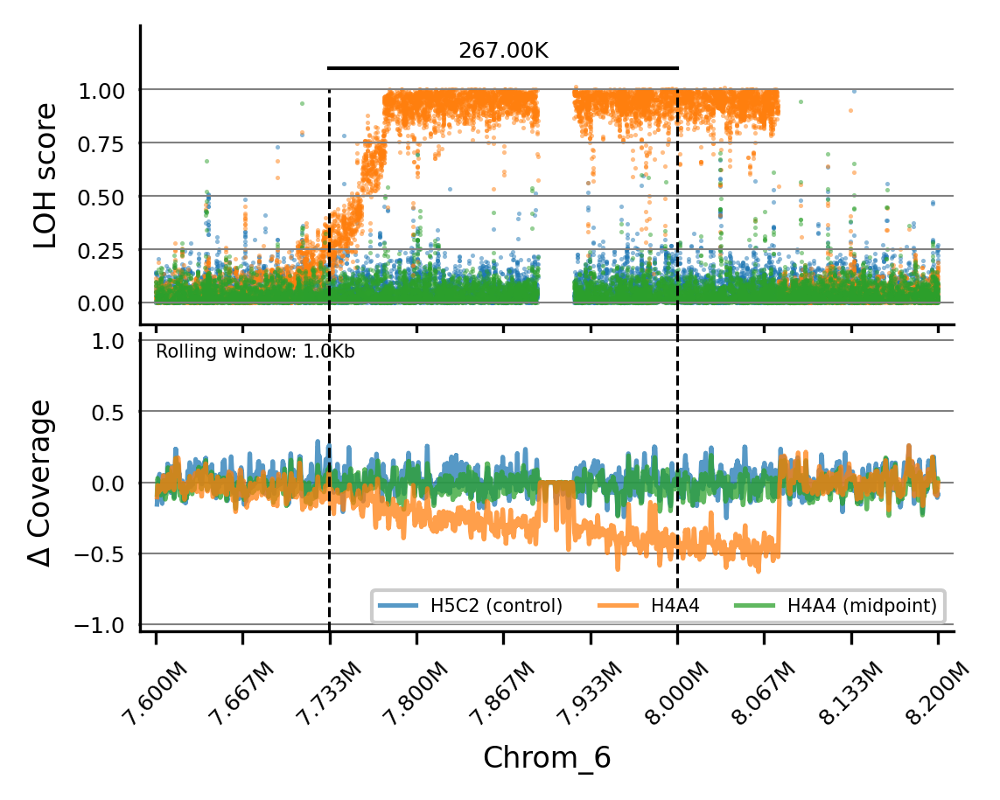

In [25]:
plot_region(
    "H4A4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 7600000, 8200000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=1000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 7733000, le = 8000000, # line starts and line ends, yl= line y value
    add_vlines = True,
)

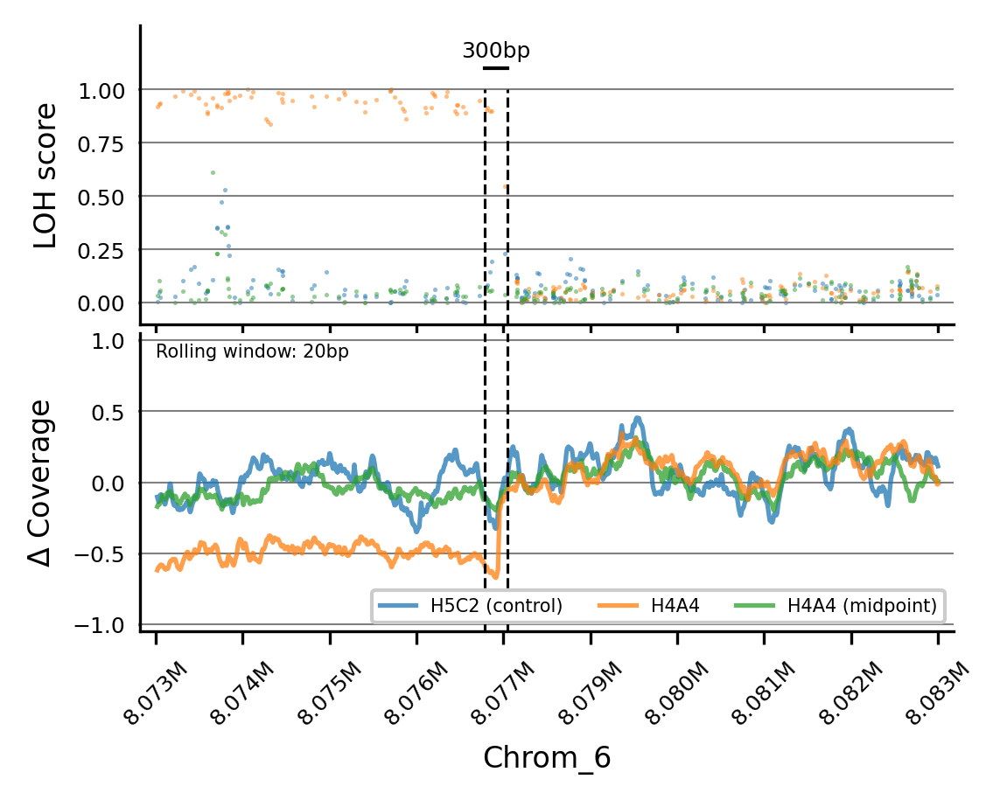

In [26]:
plot_region(
    "H4A4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 8073000, 8083000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 8077200, le = 8077500, # line starts and line ends, yl = line y value
    add_vlines = True,
)

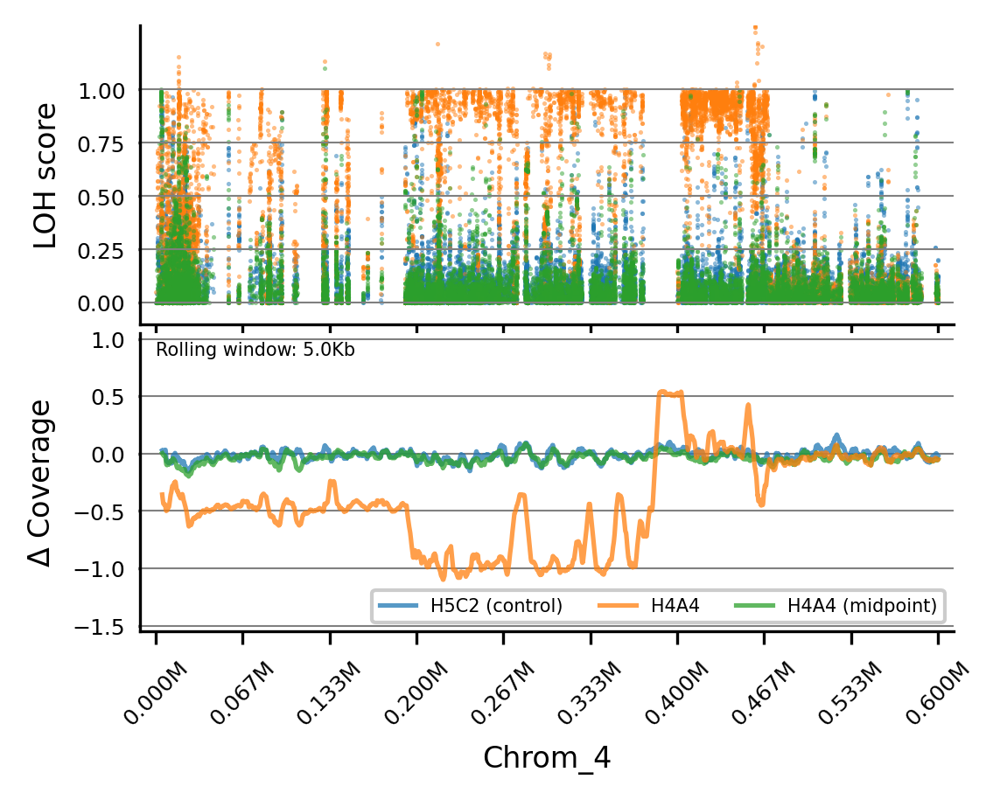

In [27]:
plot_region(
    "H4A4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 0, 600000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.55, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.5, -1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 8077200, le = 8077500, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

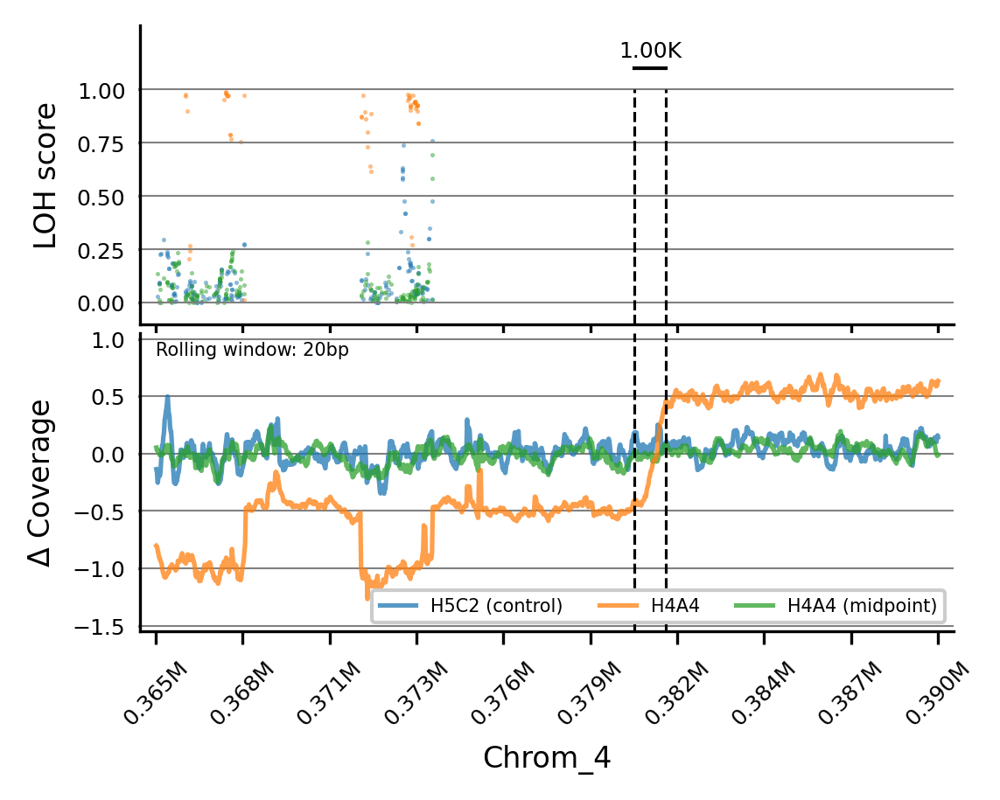

In [28]:
plot_region(
    "H4A4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 365000, 390000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.55, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.5, -1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 380300, le = 381301, # line starts and line ends, yl = line y value
    add_vlines = True,
)

# H5A4

In [29]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("H5A4", "H5C2", cov_data, vcf_ME)

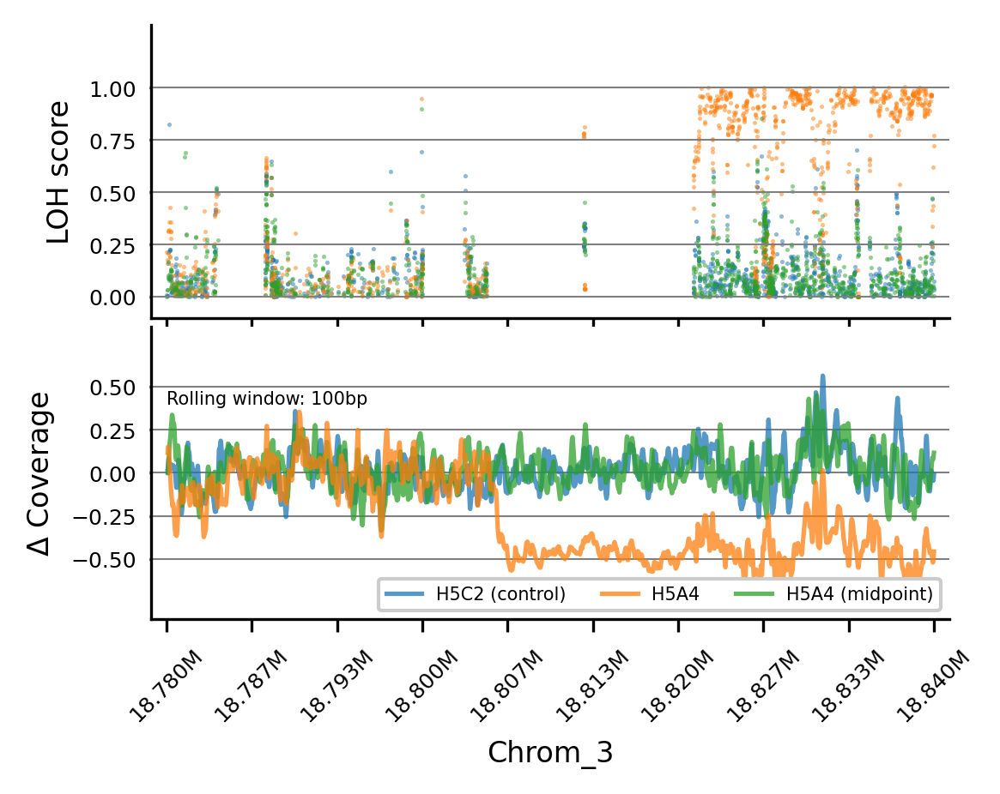

In [30]:
plot_region(
    "H5A4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 18780000, 18840000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=100, # smoothing for coverage
    cymin = -0.85, cymax = 0.85, # coverage ymin coverage ymax
    #ls = 18750000, le = 18850000, # line starts and line ends, yl= line y value
)

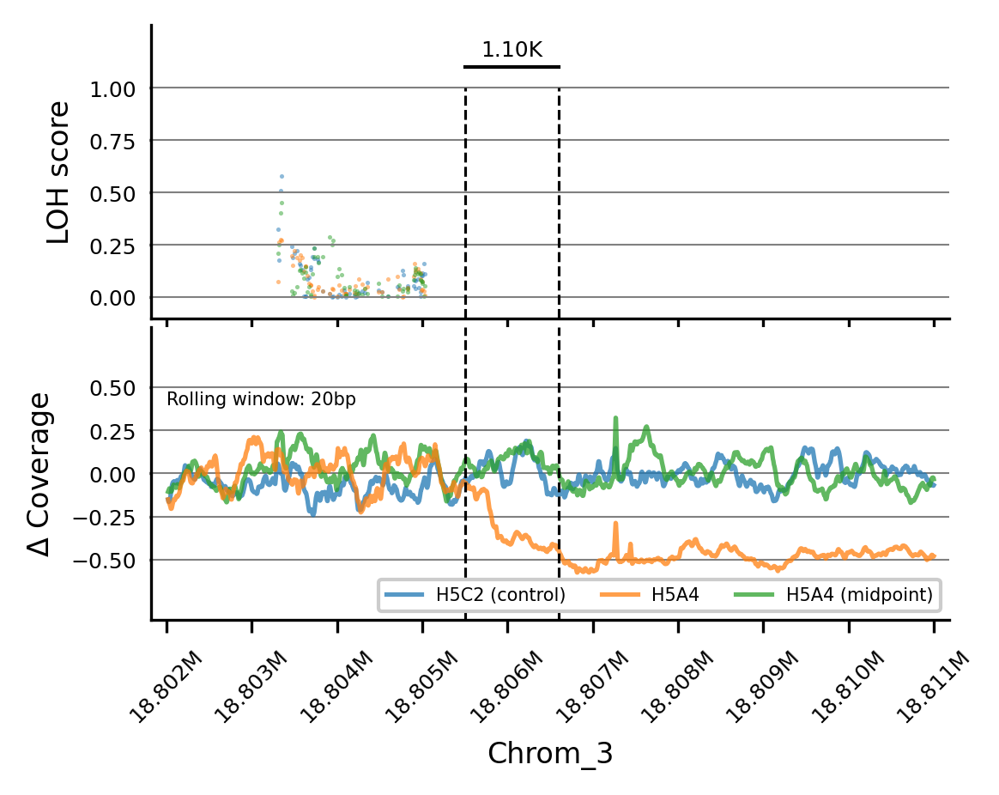

In [31]:
plot_region(
    "H5A4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 18802000, 18811000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -0.85, cymax = 0.85, # coverage ymin coverage ymax
    ls = 18805500, le = 18806601, # line starts and line ends, yl= line y value
    add_vlines = True,
)

# H2A3

In [32]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("H2A3", "H5C2", cov_data, vcf_ME)

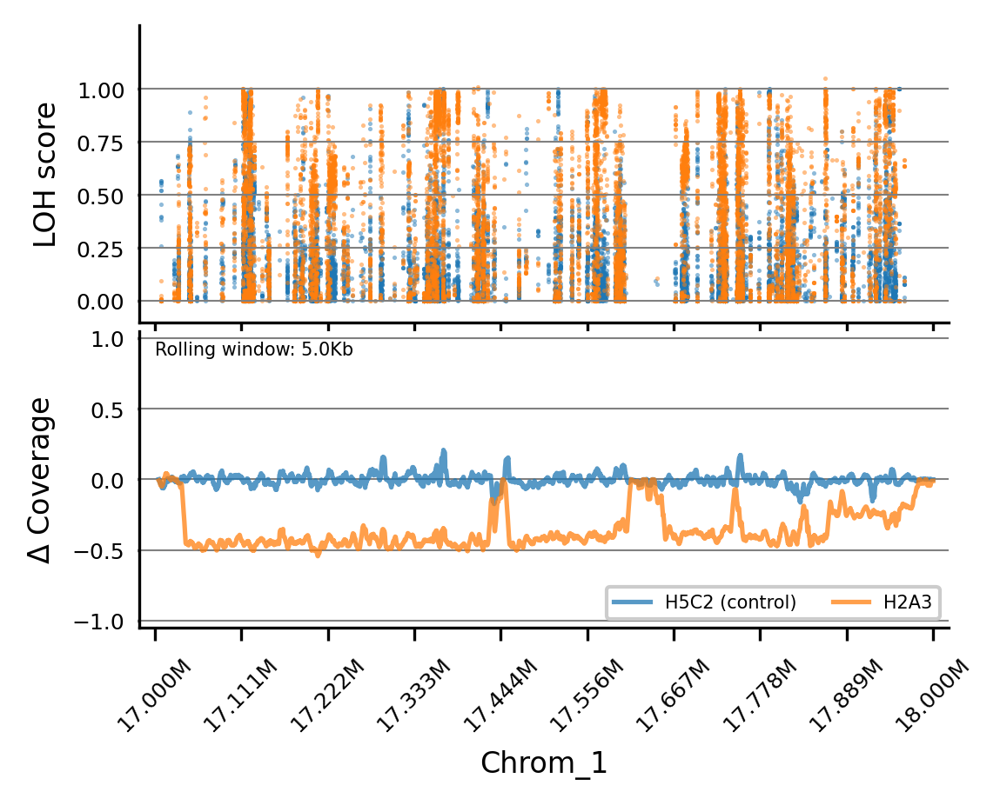

In [33]:
plot_region(
    "H2A3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 17000000, 18000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 4000000, le = 5000000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

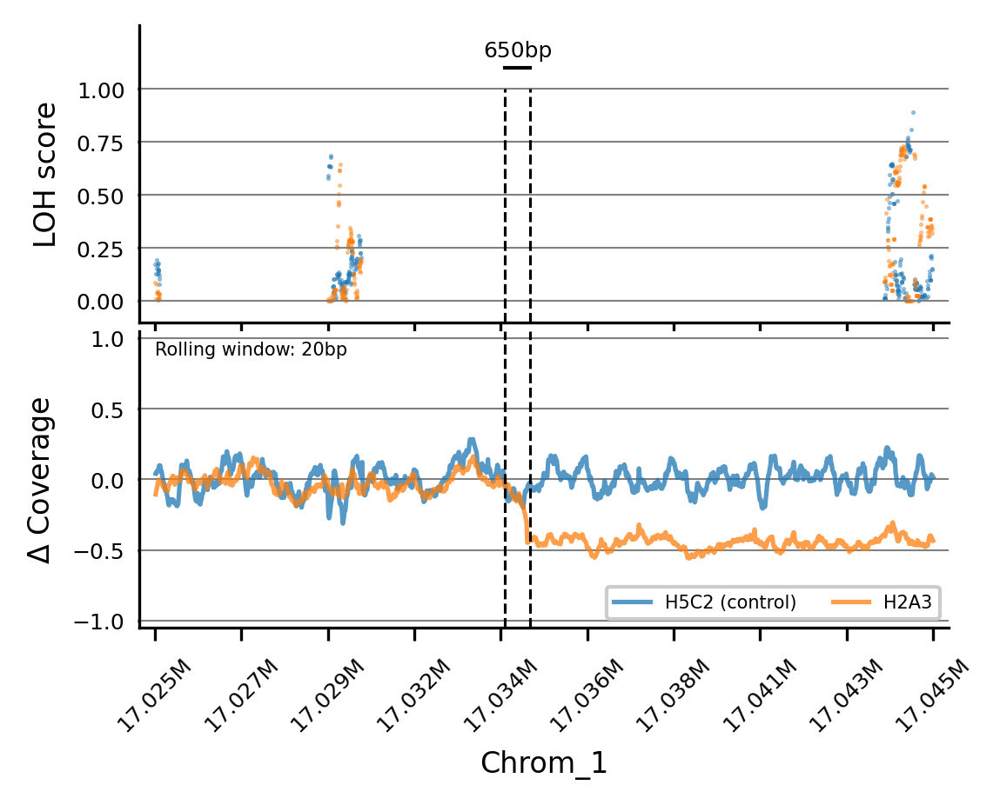

In [34]:
plot_region(
    "H2A3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 17025000, 17045000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 17034000, le = 17034650, # line starts and line ends, yl = line y value
    add_vlines = True,
)

# H2C3

In [35]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("H2C3", "H5C2", cov_data, vcf_ME)

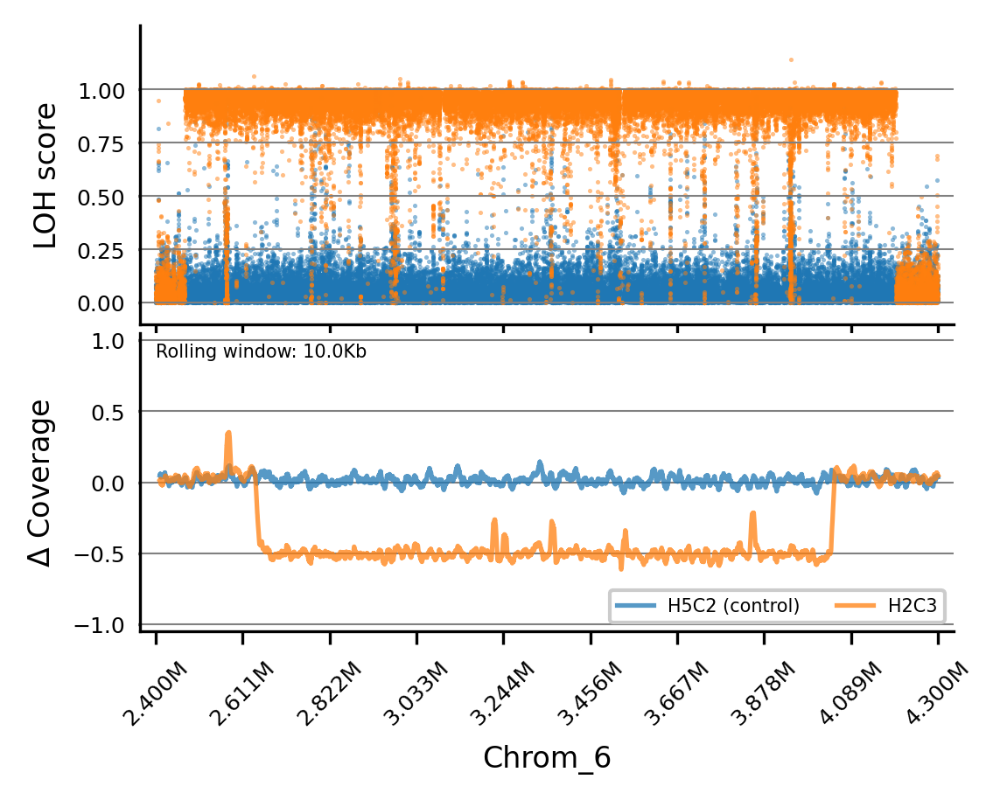

In [36]:
plot_region(
    "H2C3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 2400000, 4300000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=10000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 4000000, le = 5000000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

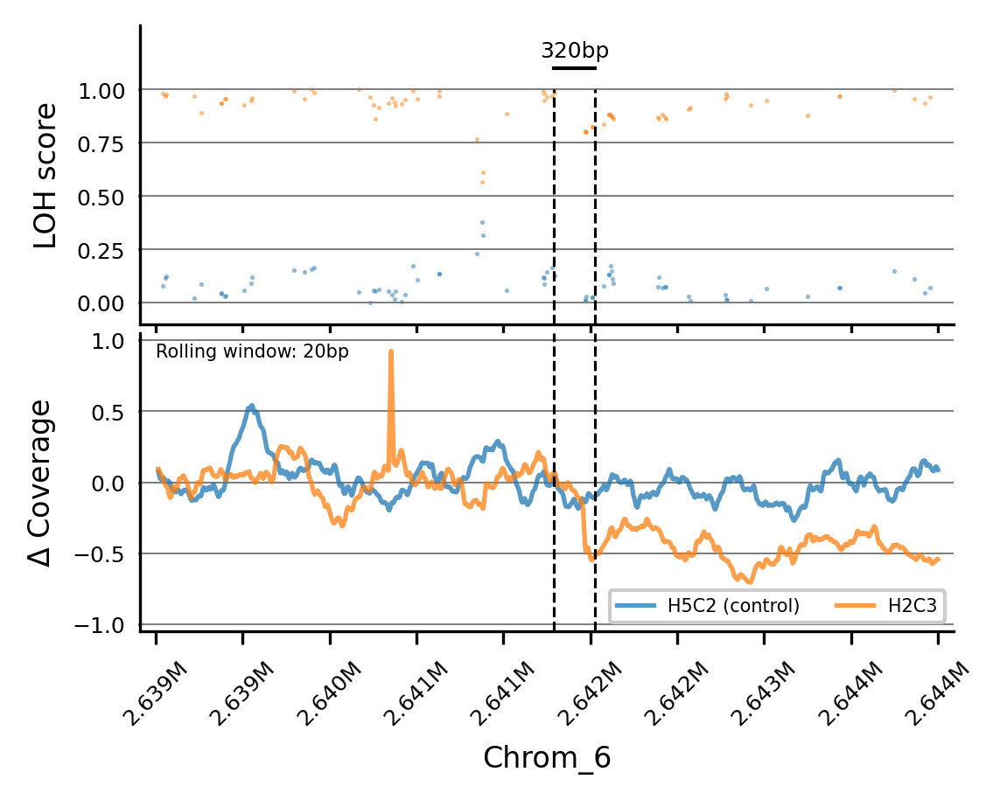

In [37]:
plot_region(
    "H2C3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 2638500, 2644500, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 2641550, le = 2641870, # line starts and line ends, yl = line y value
    add_vlines = True,
)

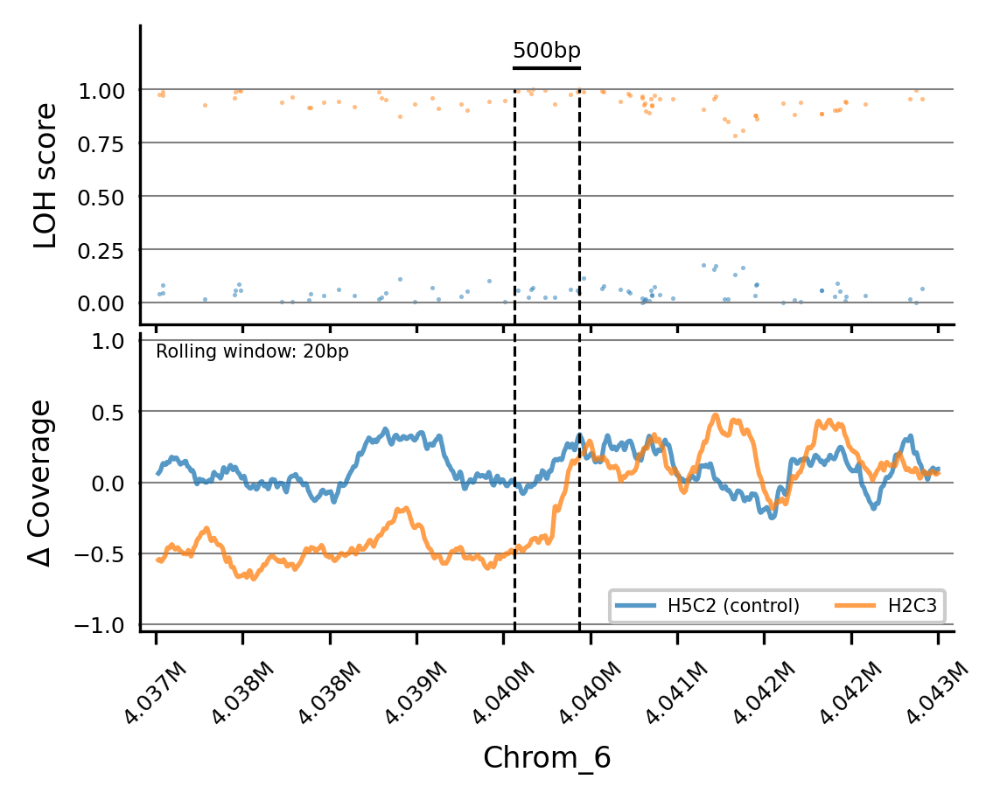

In [38]:
plot_region(
    "H2C3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 4037000, 4043000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 4039750, le = 4040250, # line starts and line ends, yl = line y value
    add_vlines = True,
)

# H4C2

In [39]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("H4C2", "H5C2", cov_data, vcf_ME)

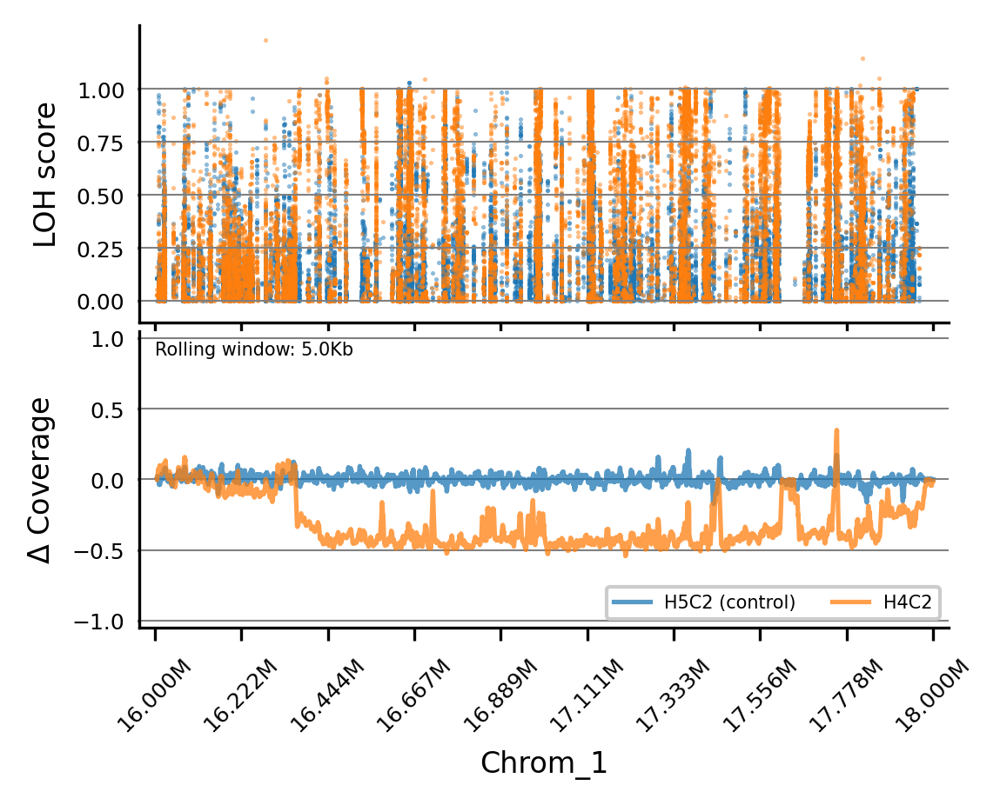

In [40]:
plot_region(
    "H4C2", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 16000000, 18000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 17000000, le = 18000000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

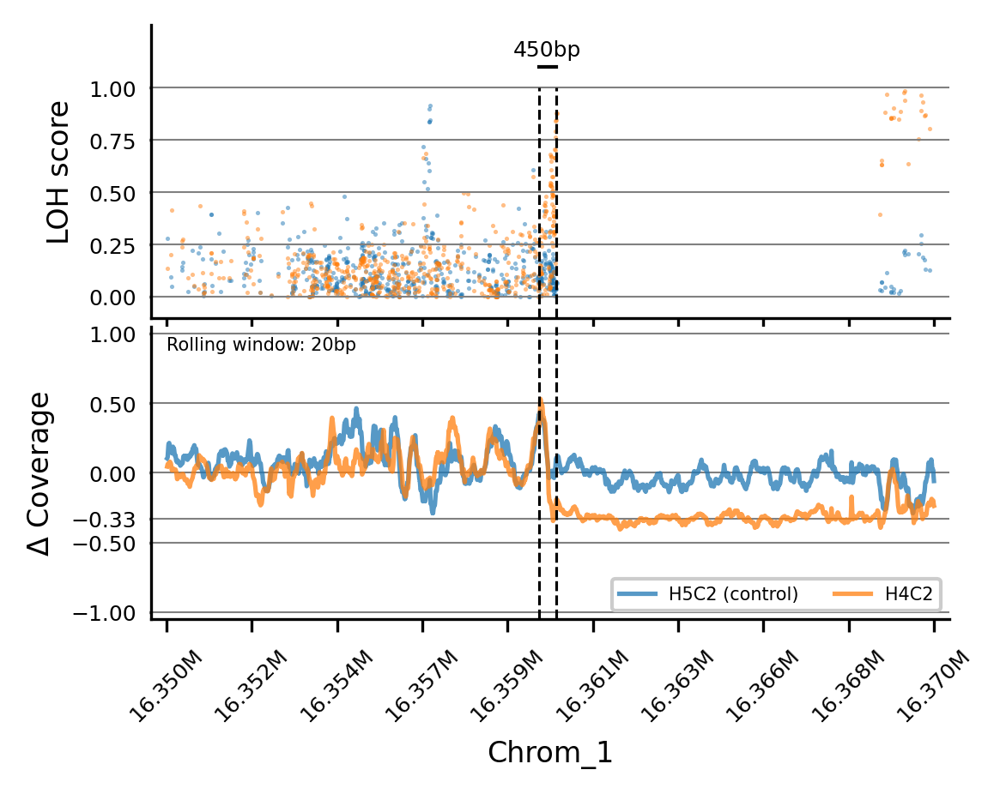

In [41]:
plot_region(
    "H4C2", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 16350000, 16370000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.33, 0.0, 0.5, 1.0],
    ls = 16359700, le = 16360150, # line starts and line ends, yl = line y value
    add_vlines = True,
)

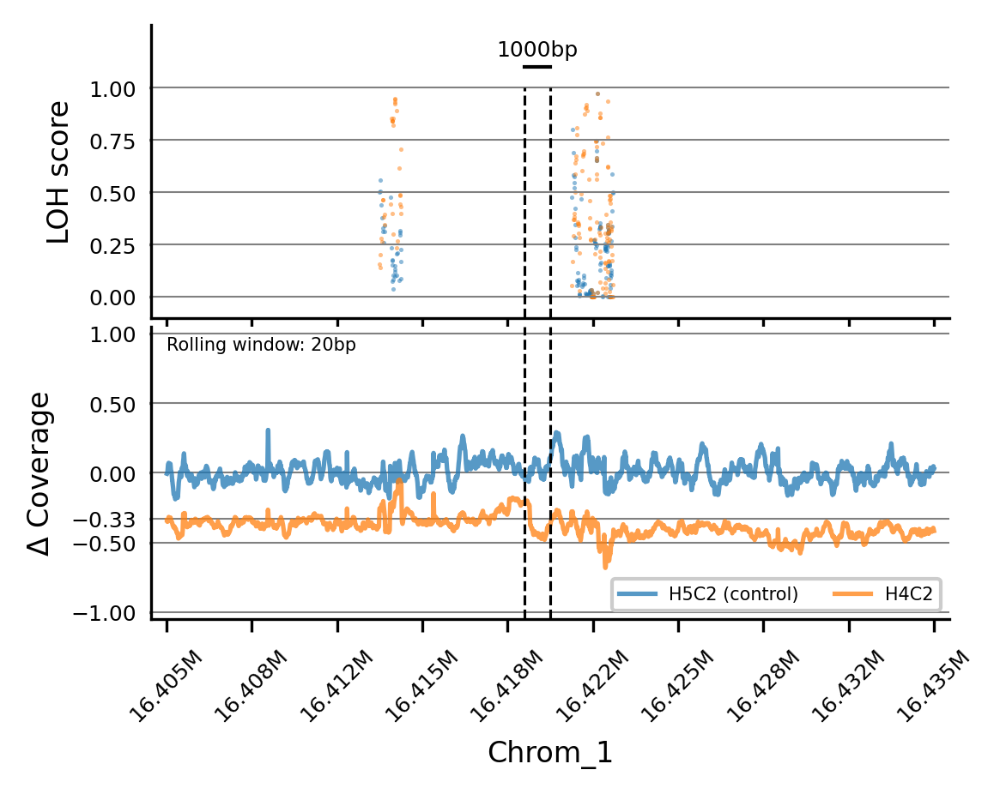

In [42]:
plot_region(
    "H4C2", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 16405000, 16435000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.33, 0.0, 0.5, 1.0],
    ls = 16419000, le = 16420000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

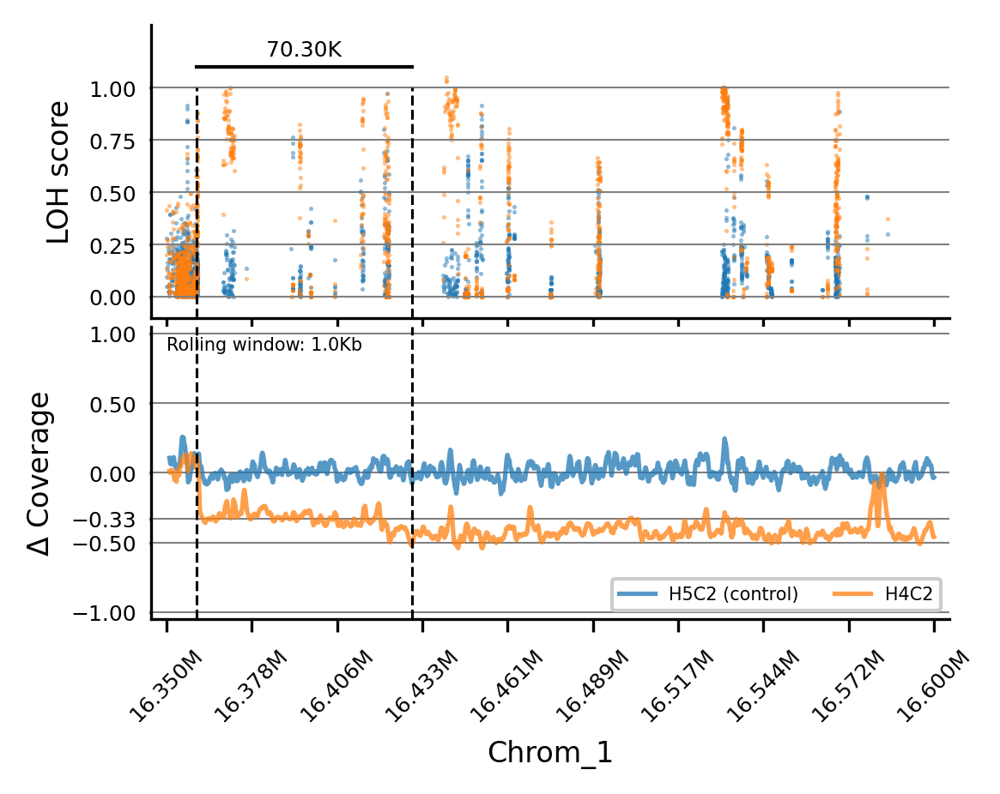

In [43]:
plot_region(
    "H4C2", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 16350000, 16600000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=1000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.33, 0.0, 0.5, 1.0],
    ls = 16359700, le = 16430000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

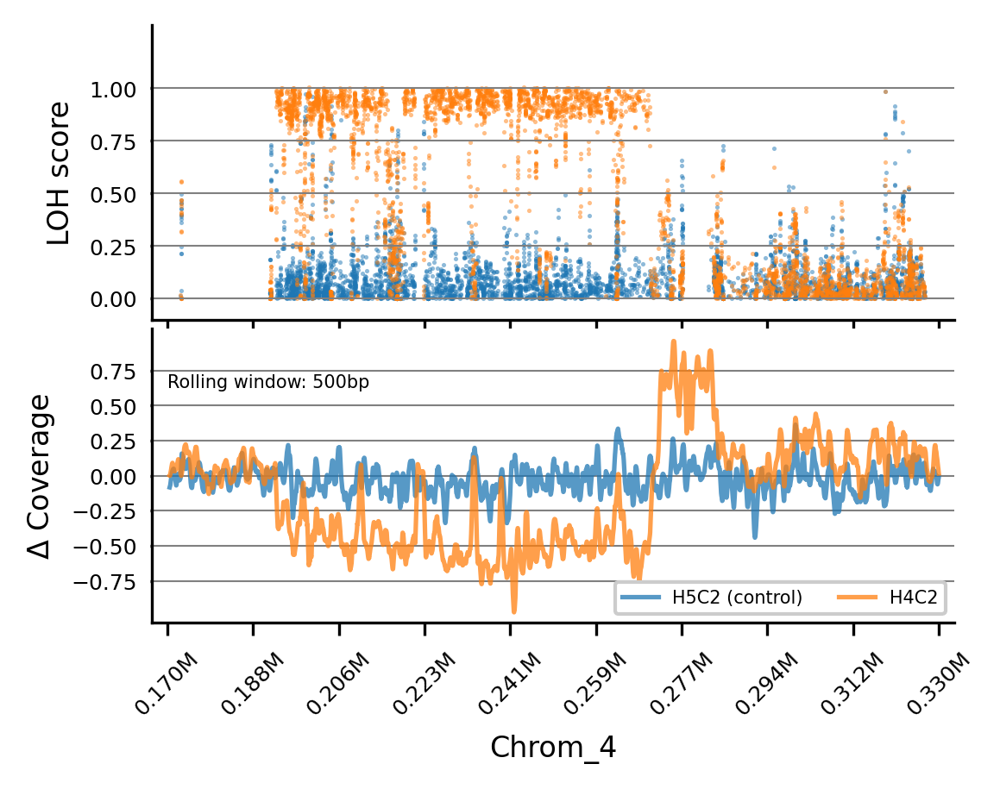

In [44]:
plot_region(
    "H4C2", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 170000, 330000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=500, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-0.75, -0.5, -0.25, 0.0, 0.25, 0.5, 0.75],
    #ls = 16359700, le = 16430000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

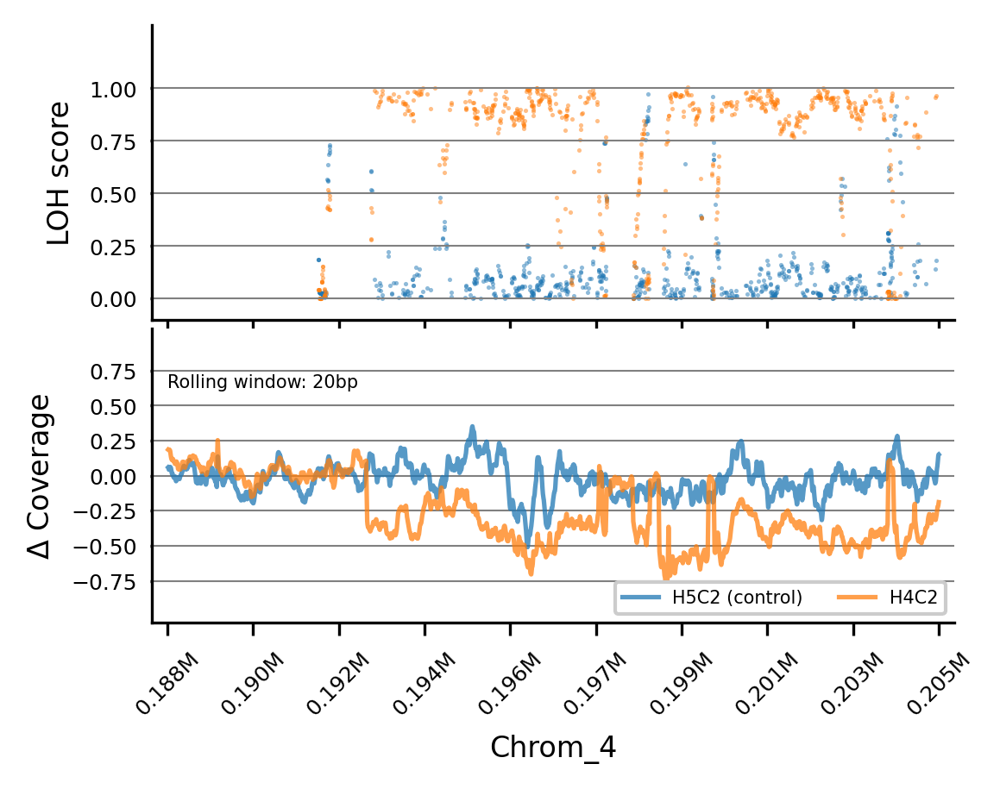

In [45]:
plot_region(
    "H4C2", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 188000, 205000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-0.75, -0.5, -0.25, 0.0, 0.25, 0.5, 0.75],
    #ls = 16359700, le = 16430000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

# D2C1

In [46]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("D2C1", "H5C2", cov_data, vcf_ME)

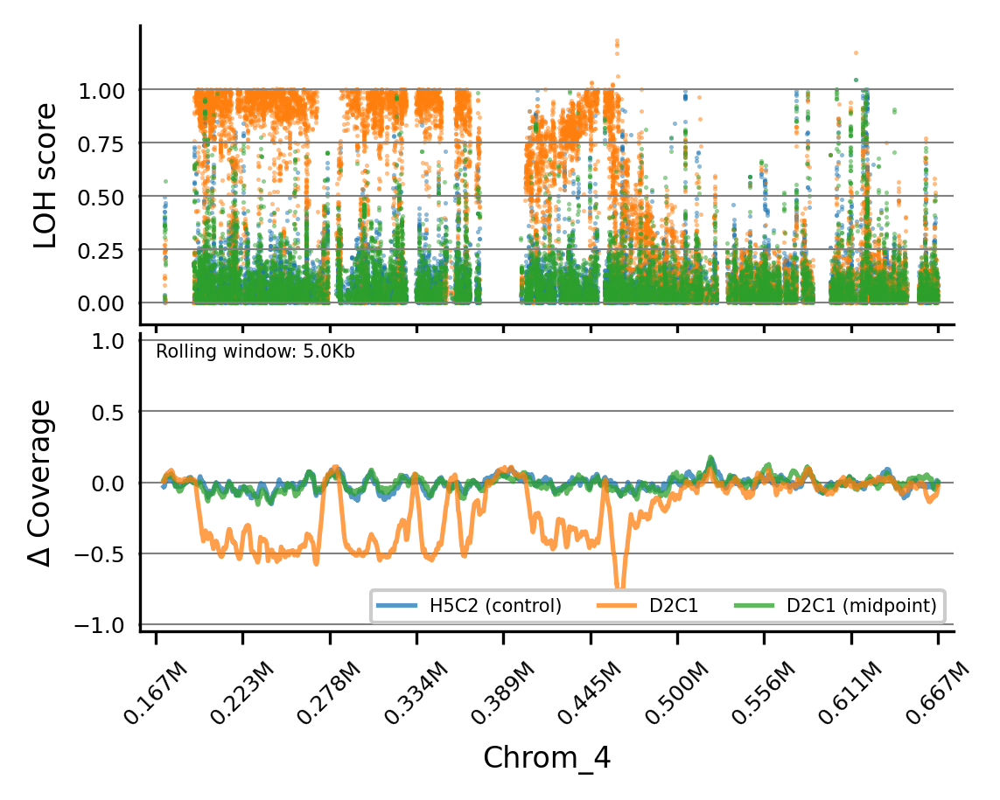

In [47]:
plot_region(
    "D2C1", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 167000, 667000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 18805500, le = 18806601, # line starts and line ends, yl= line y value
    #add_vlines = True,
)

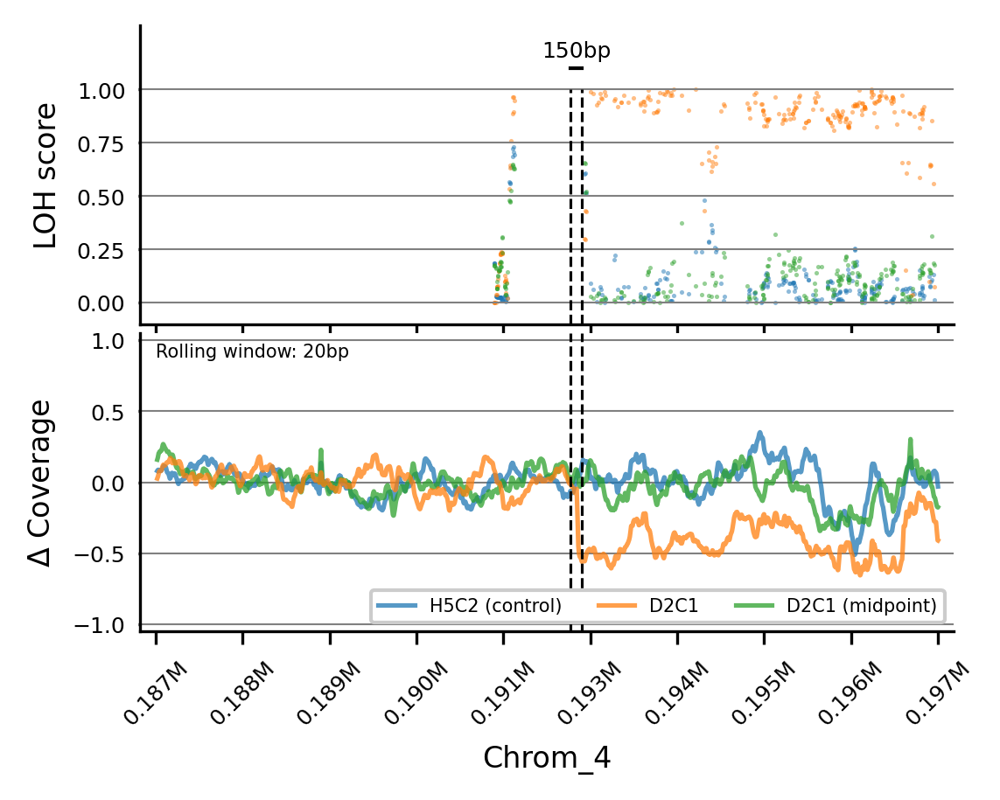

In [48]:
plot_region(
    "D2C1", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 187000, 197000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 192300, le = 192450, # line starts and line ends, yl= line y value
    add_vlines = True,
)

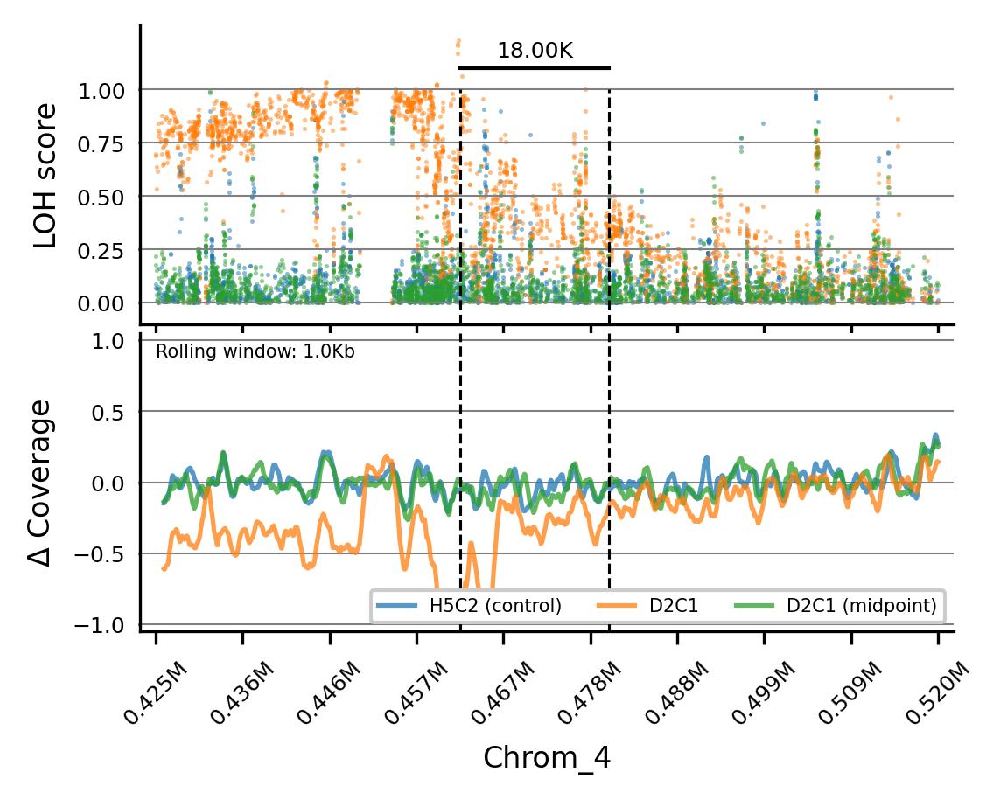

In [49]:
plot_region(
    "D2C1", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 425000, 520000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=1000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 462000, le = 480000, # line starts and line ends, yl= line y value
    add_vlines = True,
)

# D4B4

In [50]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("D4B4", "H5C2", cov_data, vcf_ME)

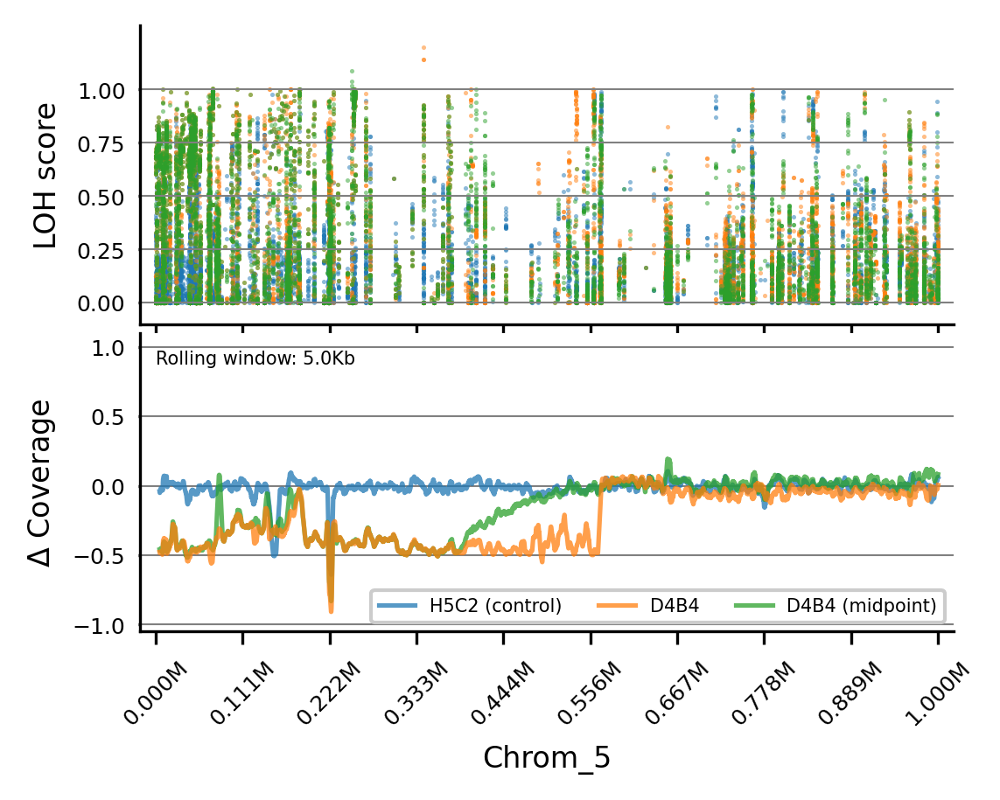

In [51]:
plot_region(
    "D4B4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_5", 0, 1000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.1, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 18805500, le = 18806601, # line starts and line ends, yl= line y value
    #add_vlines = True,
)

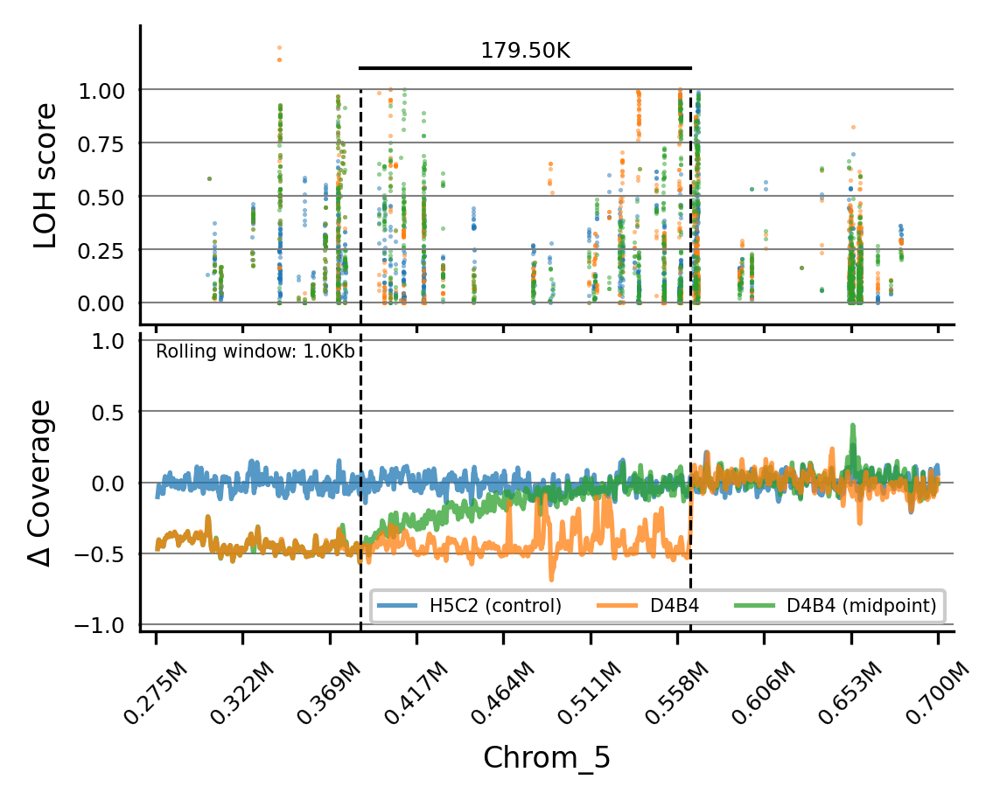

In [52]:
plot_region(
    "D4B4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_5", 275000, 700000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=1000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 386000, le = 565500, # line starts and line ends, yl= line y value
    add_vlines = True,
)

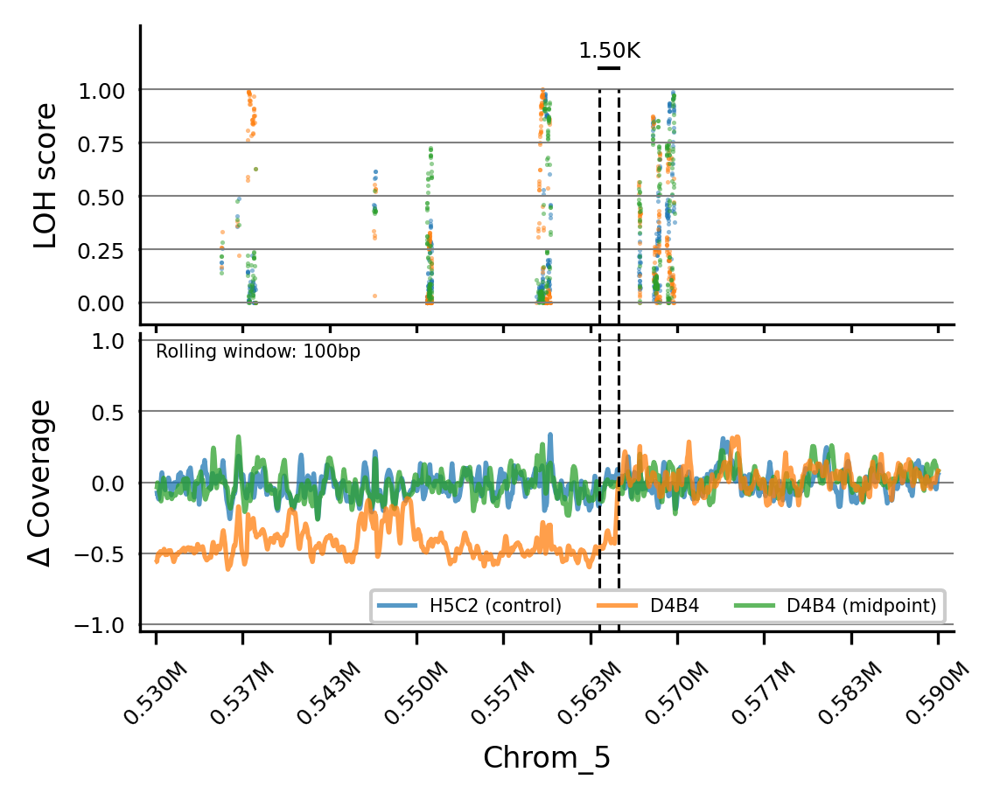

In [53]:
plot_region(
    "D4B4", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_5", 530000, 590000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=100, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 564000, le = 565500, # line starts and line ends, yl= line y value
    add_vlines = True,
)

# D5C3

In [54]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("D5C3", "H5C2", cov_data, vcf_ME)

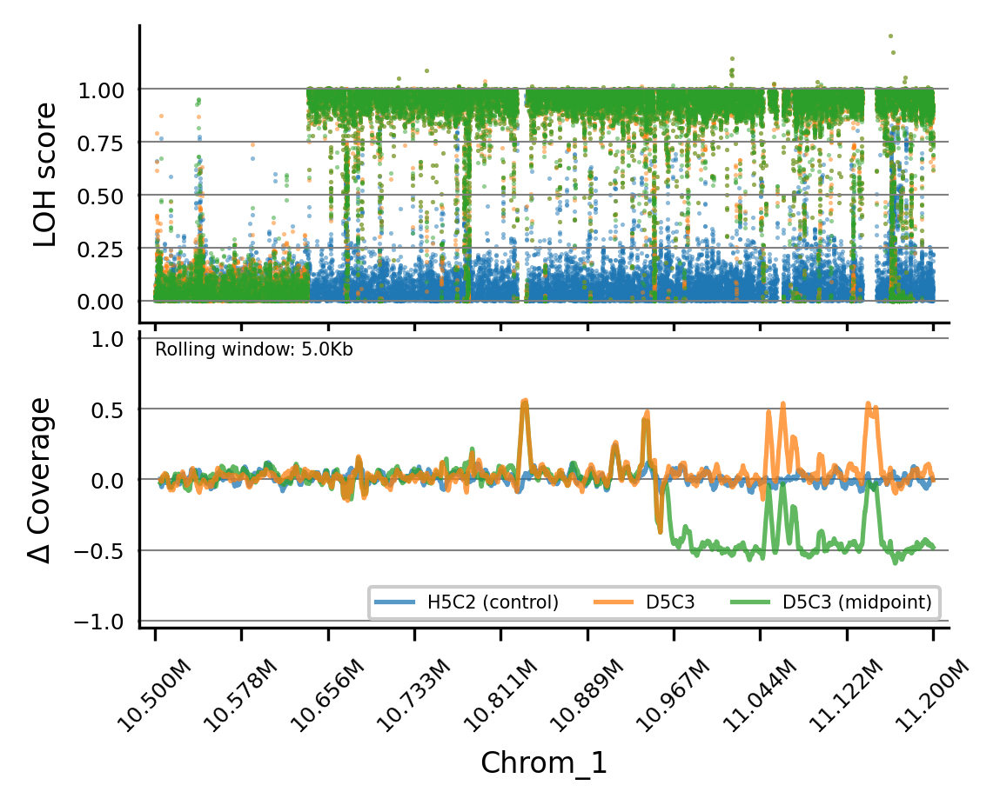

In [55]:
plot_region(
    "D5C3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 10500000, 11200000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 18805500, le = 18806601, # line starts and line ends, yl= line y value
    #add_vlines = True,
)

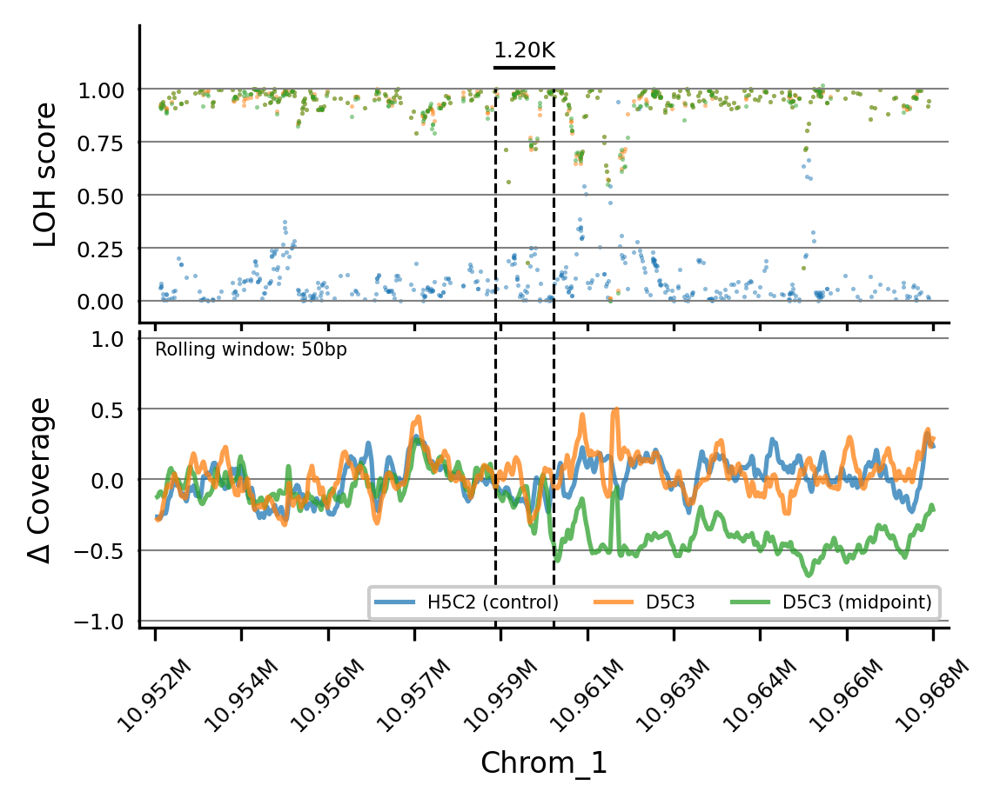

In [56]:
plot_region(
    "D5C3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 10952000, 10968000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=50, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 10959000, le = 10960200, # line starts and line ends, yl= line y value
    add_vlines = True,
)

# D5B3

In [57]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("D5B3", "H5C2", cov_data, vcf_ME)

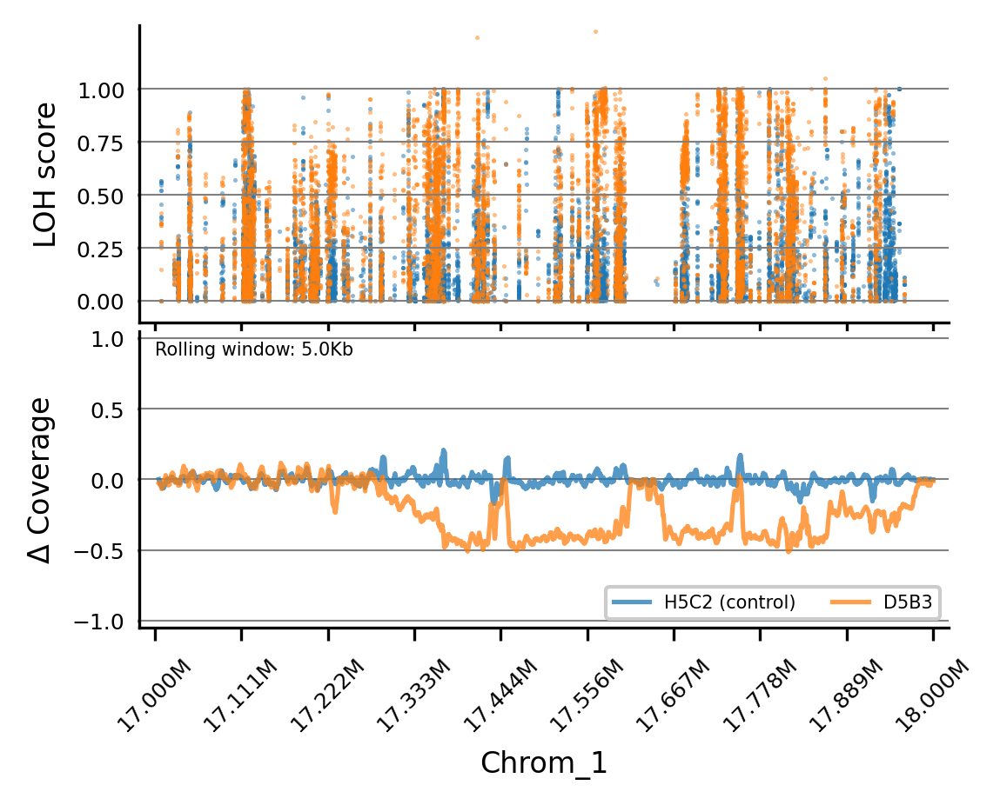

In [58]:
plot_region(
    "D5B3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 17000000, 18000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 4039750, le = 4040250, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

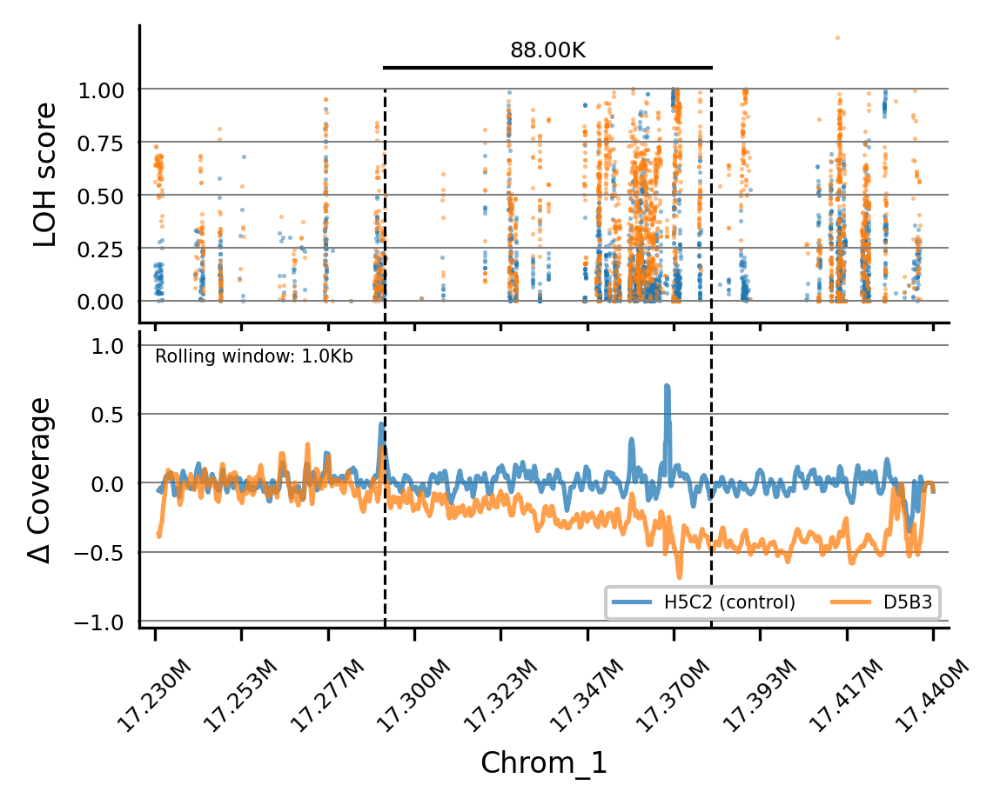

In [59]:
plot_region(
    "D5B3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 17230000, 17440000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=1000, # smoothing for coverage
    cymin = -1.05, cymax = 1.1, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 17292000, le = 17380000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

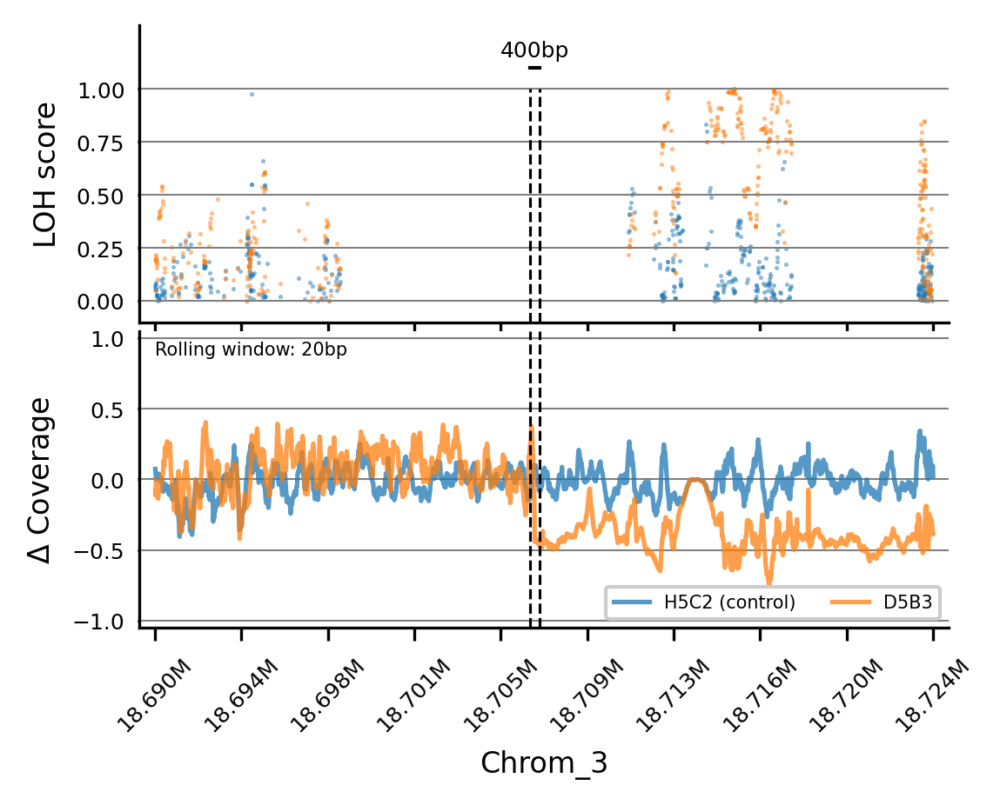

In [60]:
plot_region(
    "D5B3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 18690000, 18724000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=20, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 18706400, le = 18706800, # line starts and line ends, yl = line y value
    add_vlines = True,
)

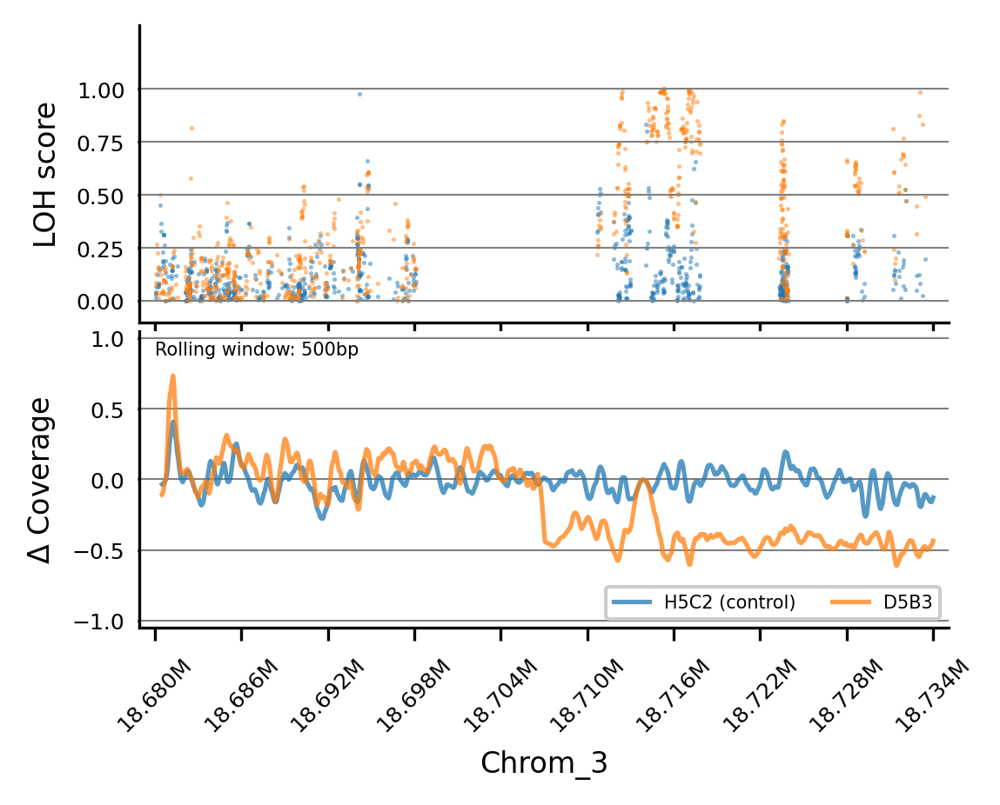

In [61]:
plot_region(
    "D5B3", "H5C2", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 18680000, 18734000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=500, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 18706400, le = 18706800, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

# P250_C8_E4

In [62]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("P250_C8_E4", "P0_C9_E4", cov_data, vcf_GR)

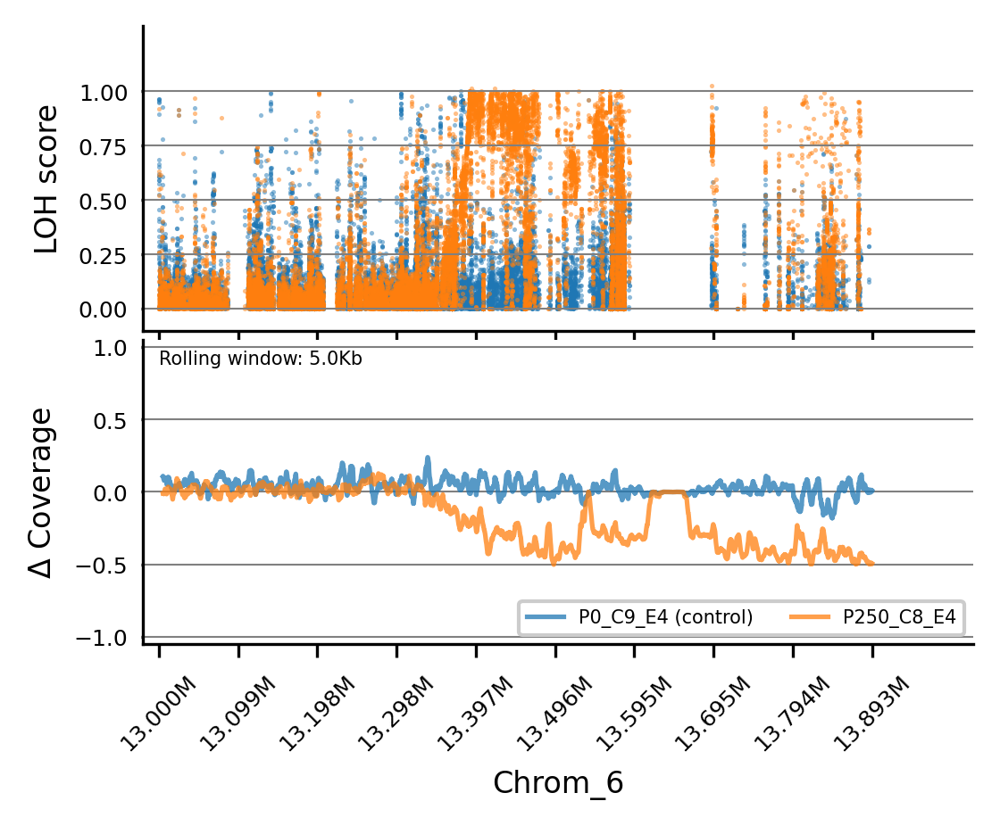

In [63]:
plot_region(
    "P250_C8_E4", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 13000000, 14000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 4039750, le = 4040250, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

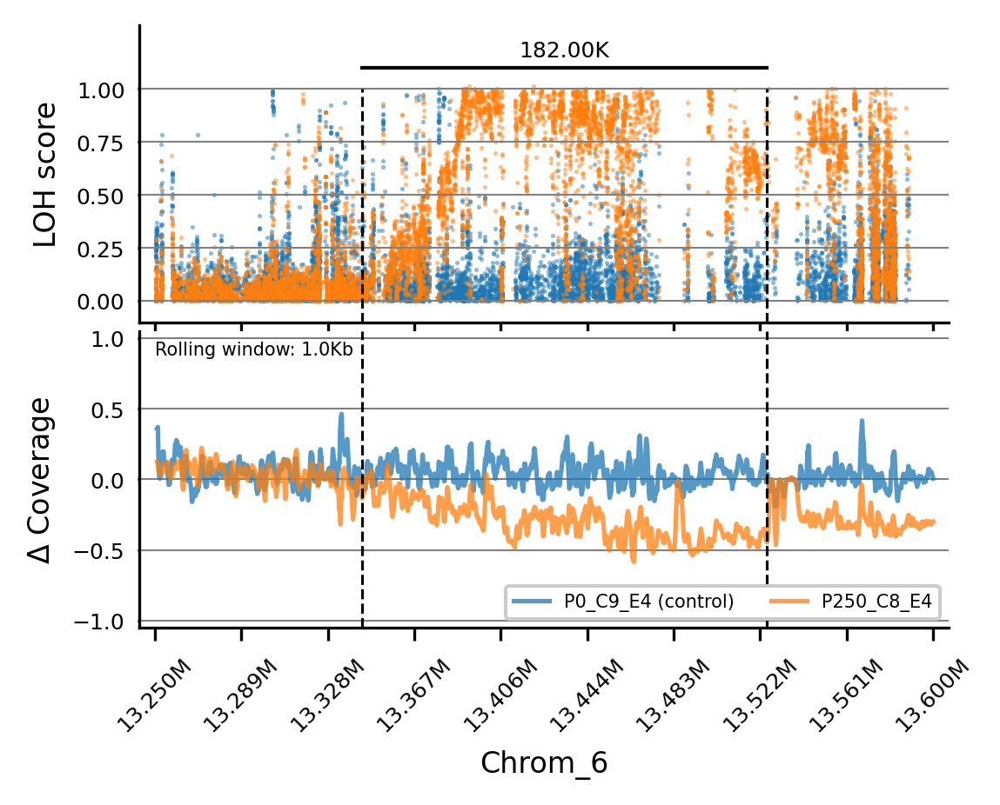

In [64]:
plot_region(
    "P250_C8_E4", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 13250000, 13600000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=1000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 13343000, le = 13525000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

# P500_C18_E3

In [65]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("P500_C18_E3", "P0_C9_E4", cov_data, vcf_GR)

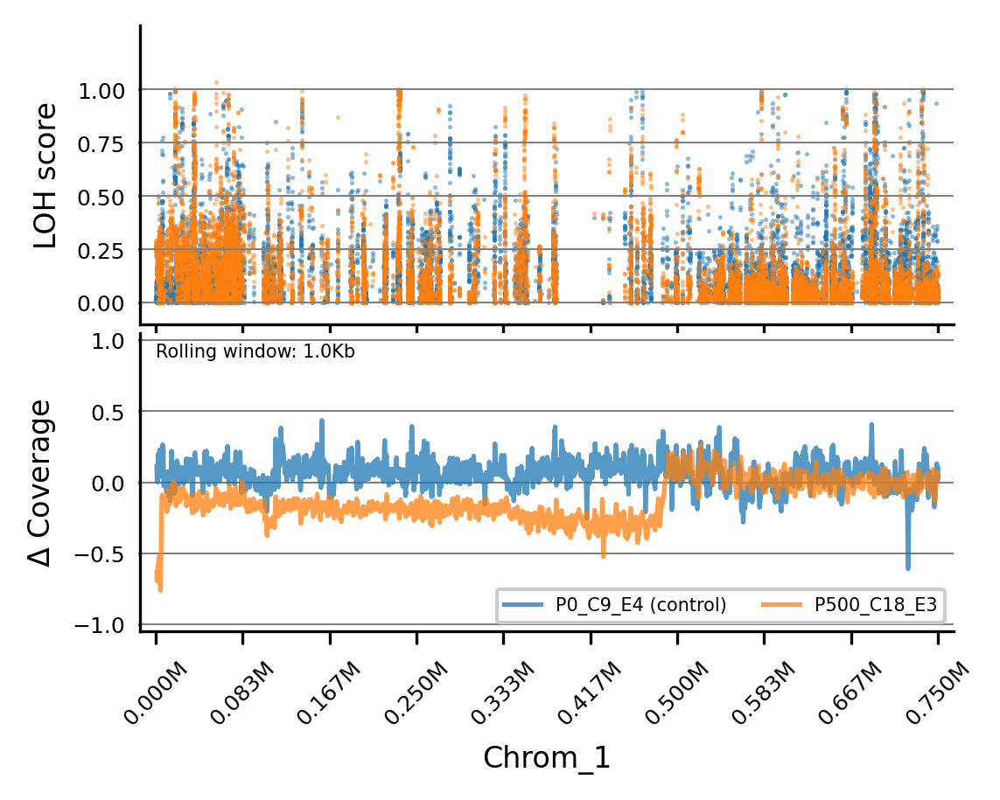

In [66]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 0, 750000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=1000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 4039750, le = 4040250, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

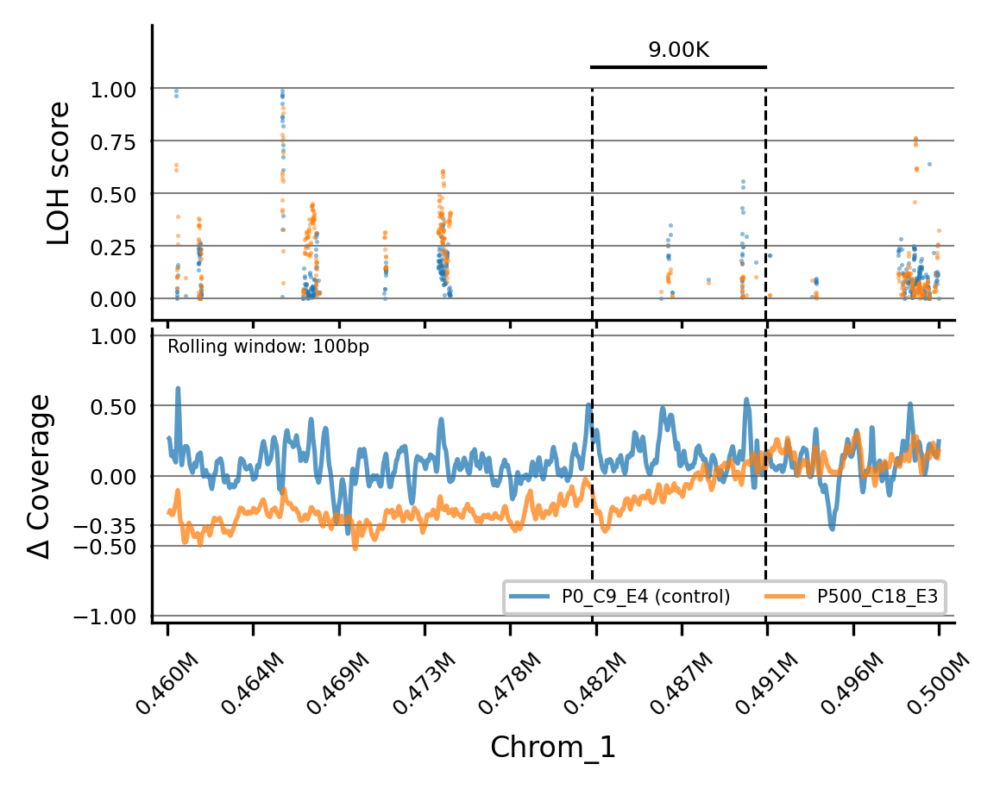

In [67]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 460000, 500000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=100, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.35, 0.0, 0.5, 1.0],
    ls = 482000, le = 491000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

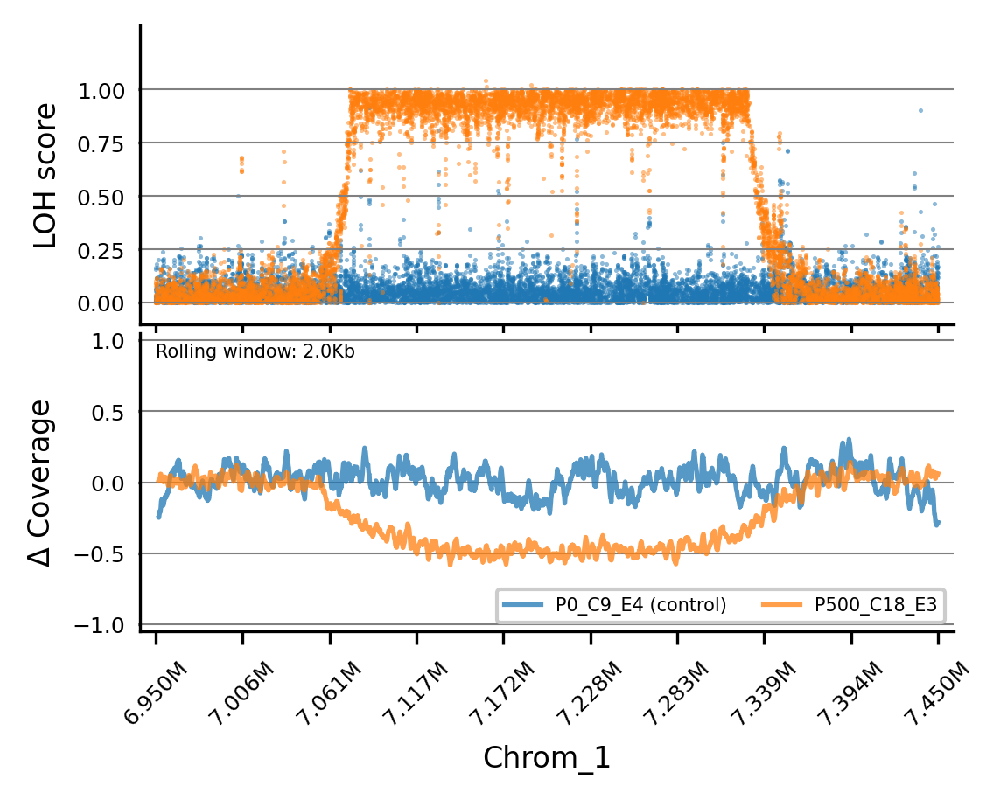

In [68]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 6950000, 7450000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 482000, le = 491000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

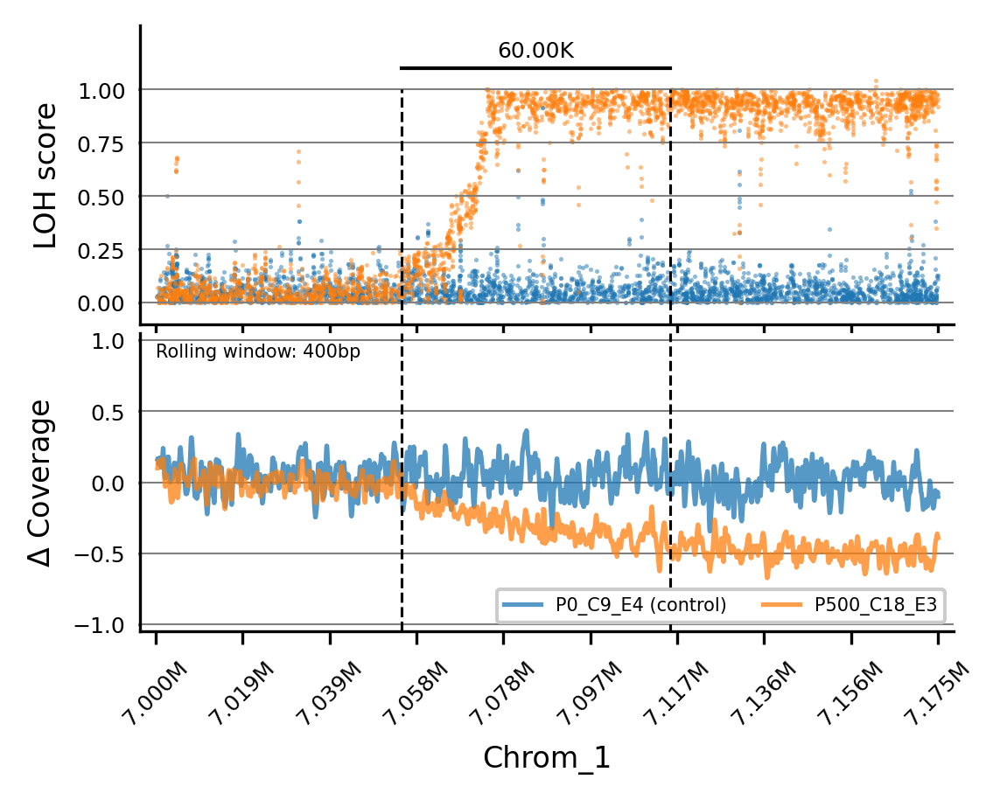

In [69]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 7000000, 7175000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=400, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 7055000, le = 7115000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

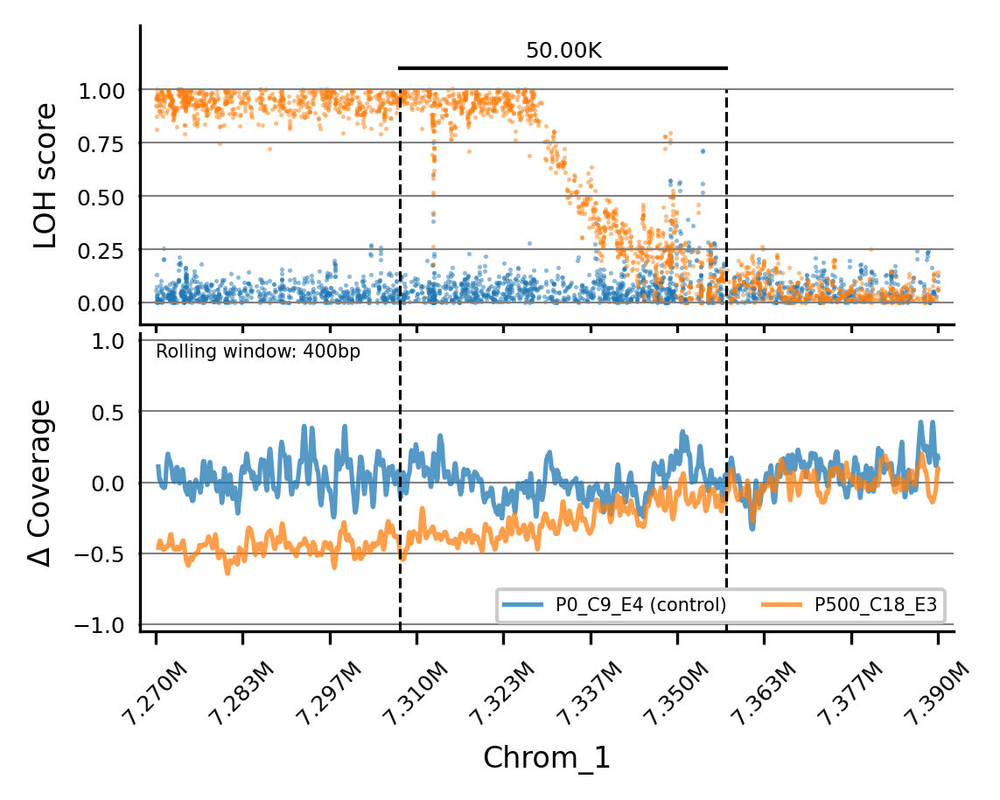

In [70]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 7270000, 7390000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=400, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 7307500, le = 7357500, # line starts and line ends, yl = line y value
    add_vlines = True,
)

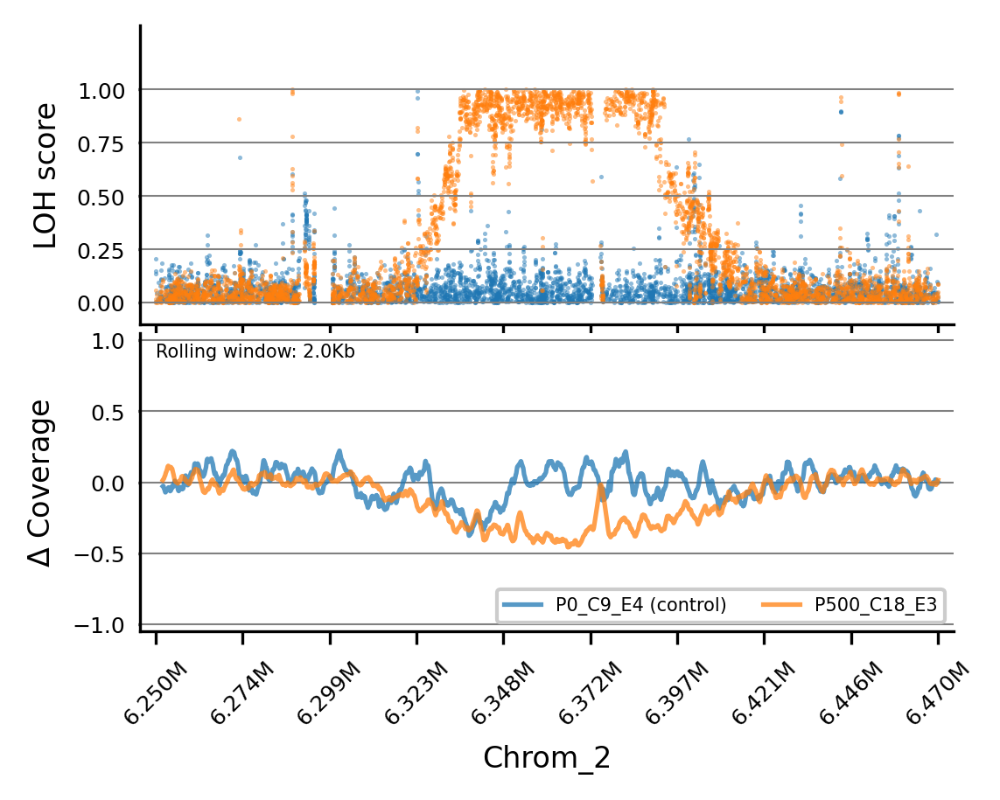

In [71]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_2", 6250000, 6470000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 7306000, le = 7356000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

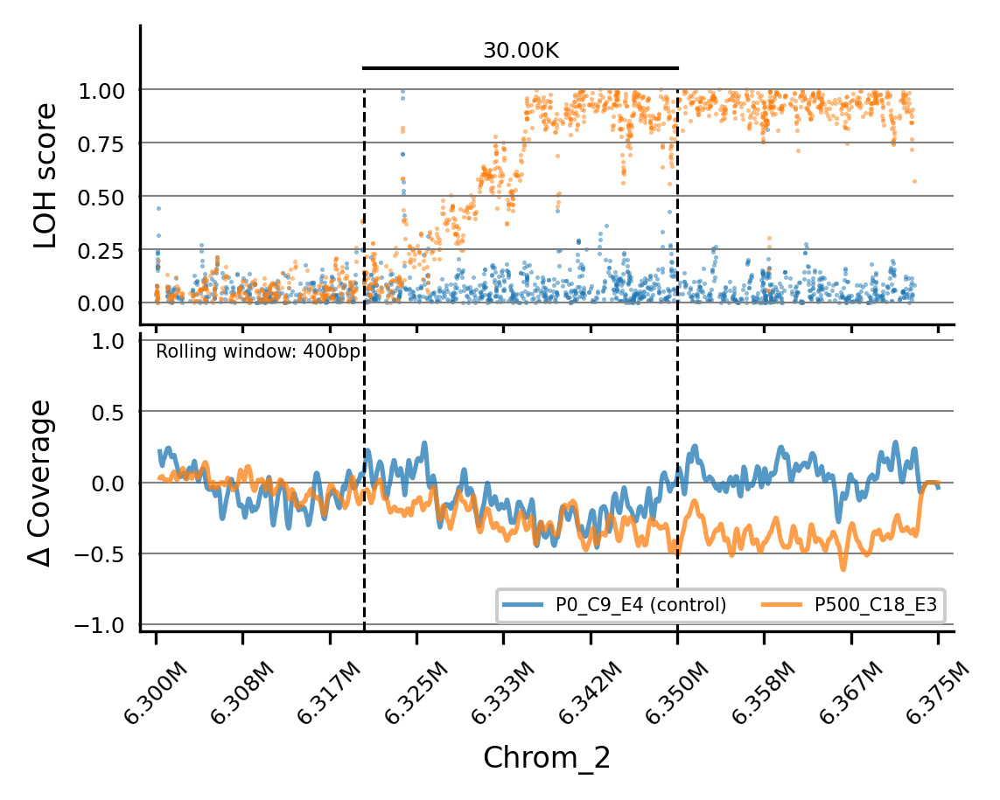

In [72]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_2", 6300000, 6375000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=400, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 6320000, le = 6350000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

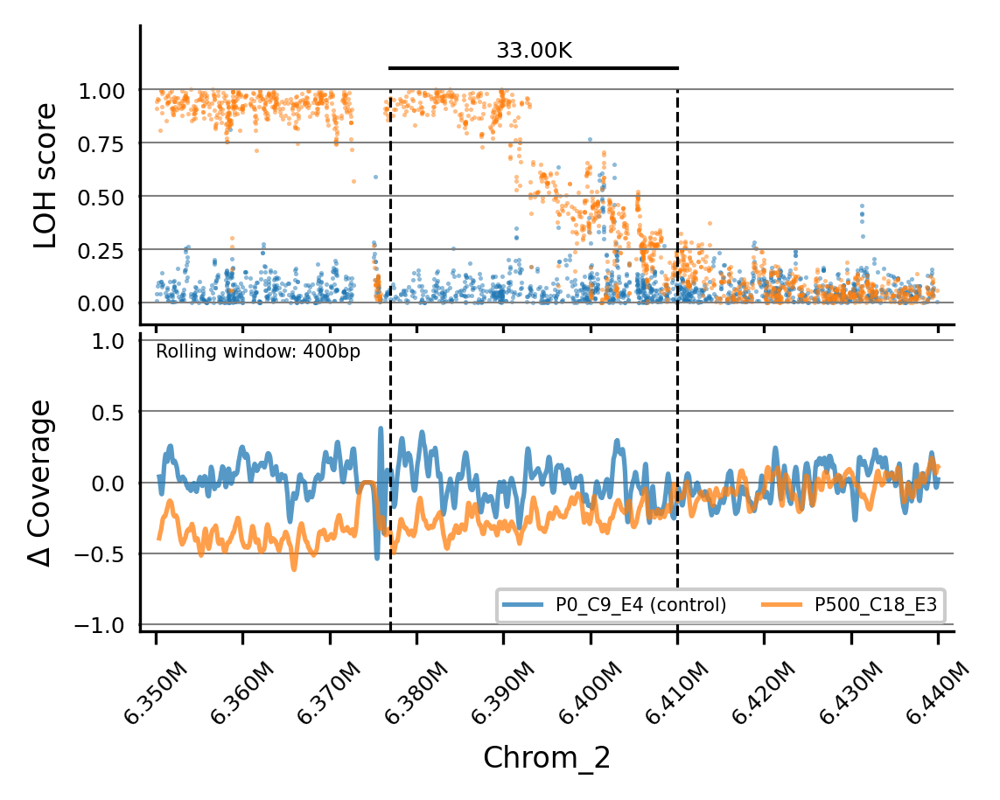

In [73]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_2", 6350000, 6440000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=400, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 6377000, le = 6410000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

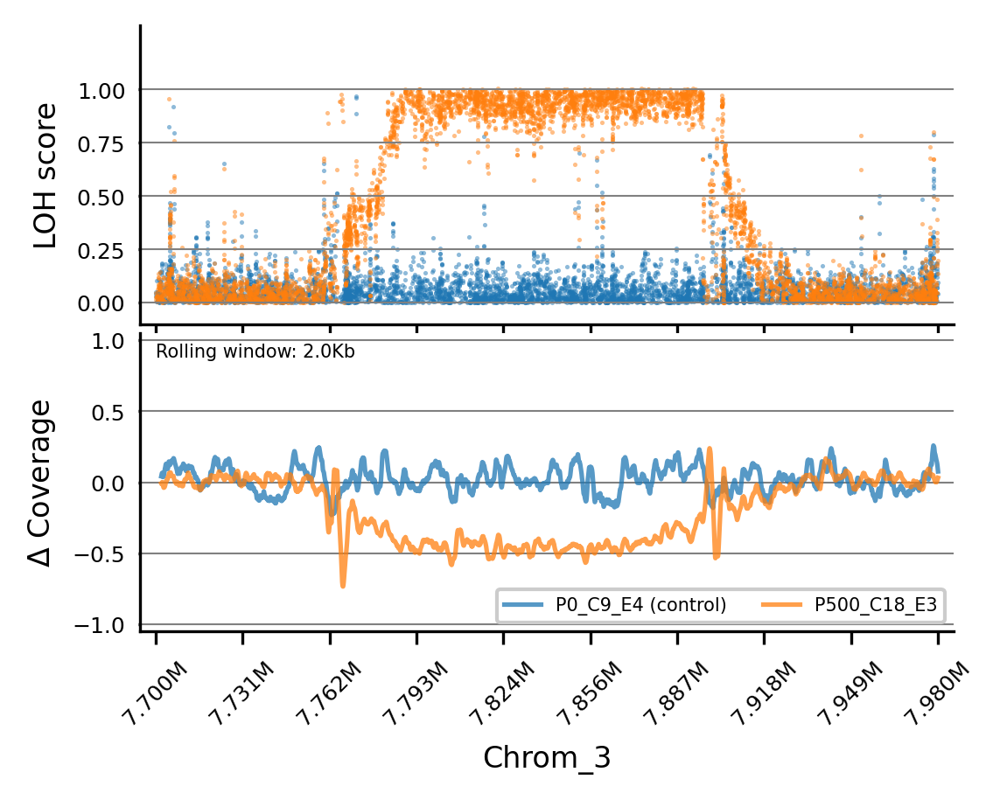

In [74]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 7700000, 7980000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 6377000, le = 6410000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

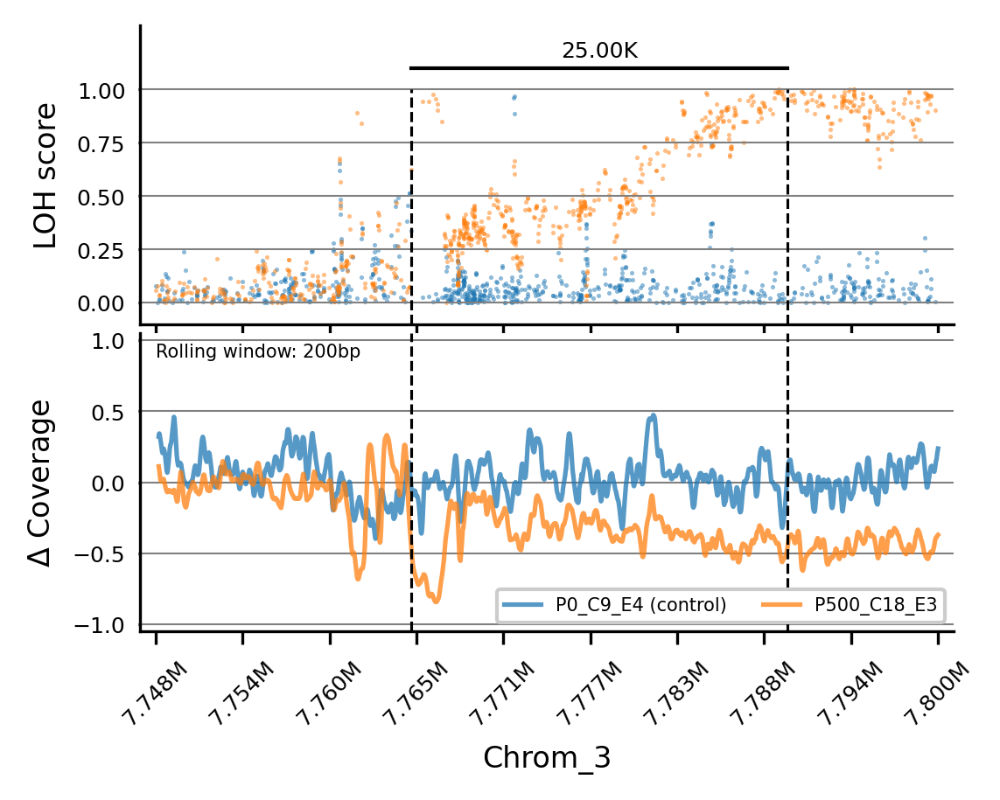

In [75]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 7748000, 7800000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=200, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 7765000, le = 7790000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

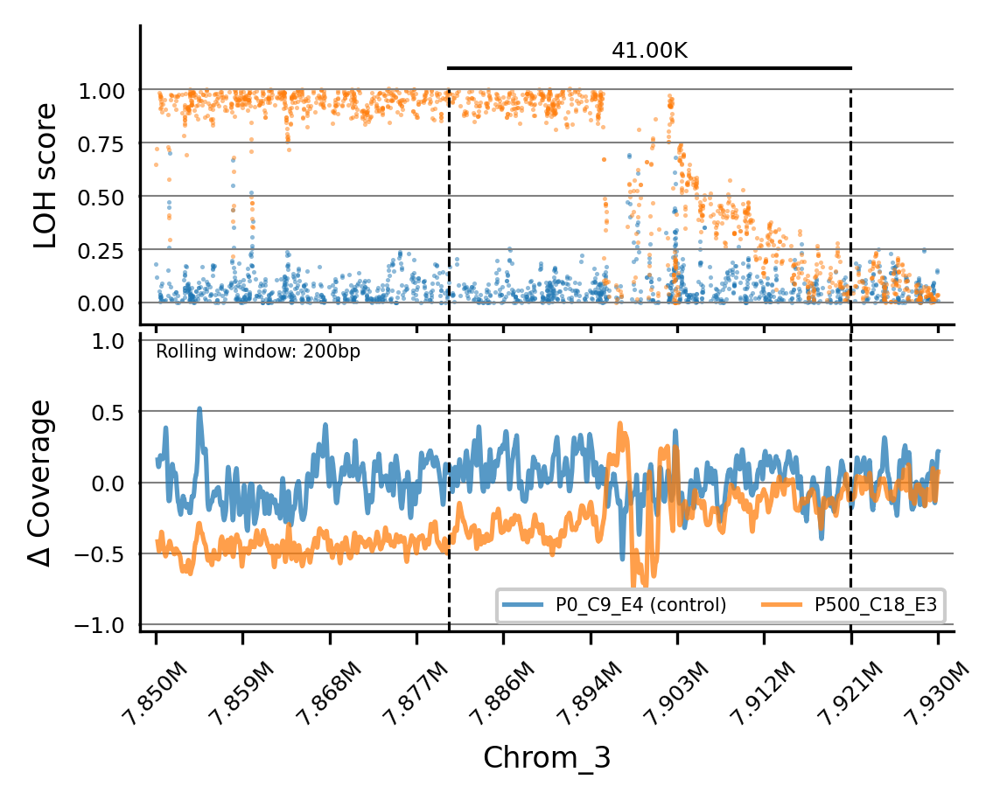

In [76]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 7850000, 7930000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=200, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 7880000, le = 7921000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

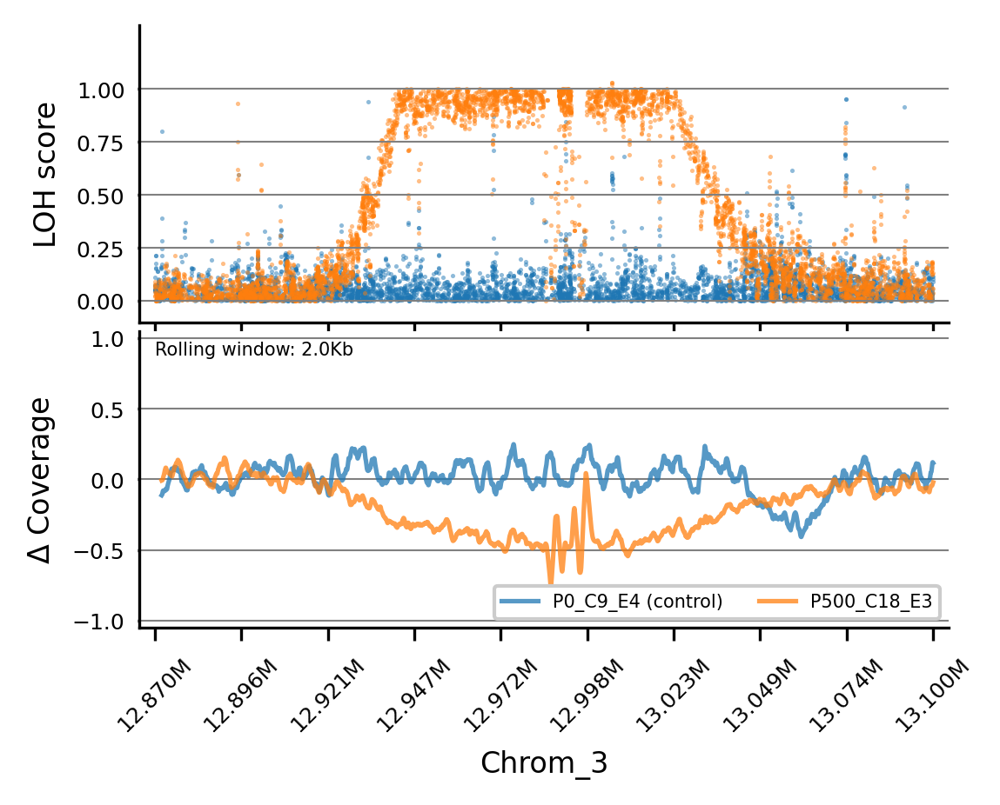

In [77]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 12870000, 13100000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 6377000, le = 6410000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

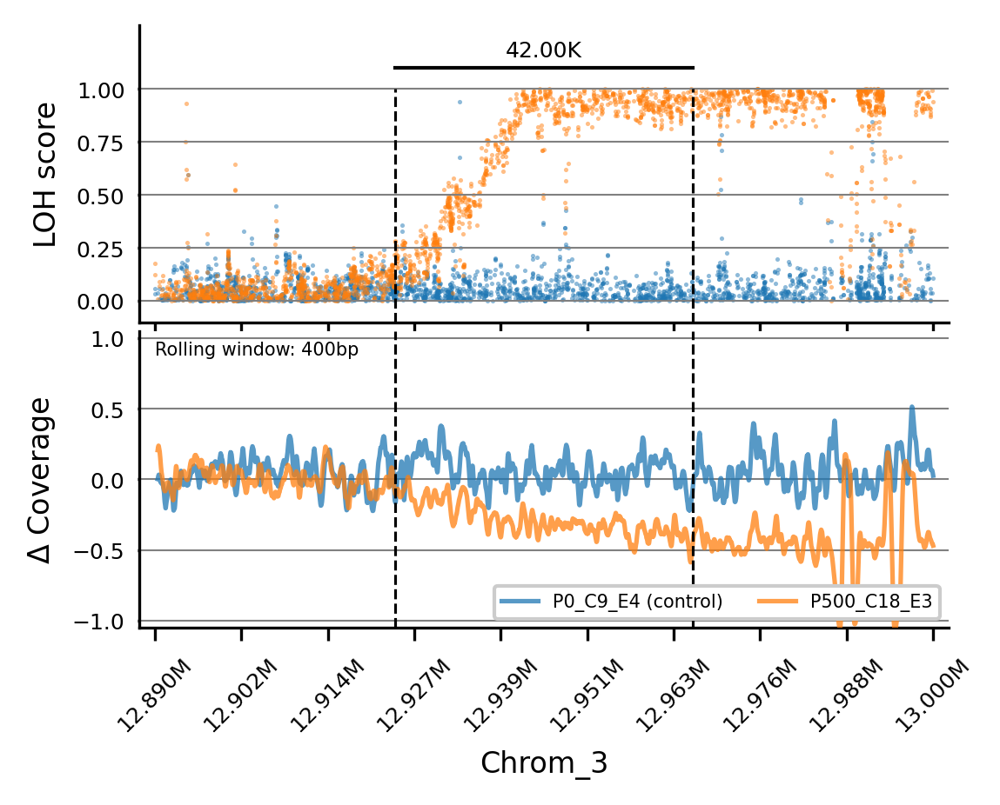

In [78]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 12890000, 13000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=400, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 12924000, le = 12966000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

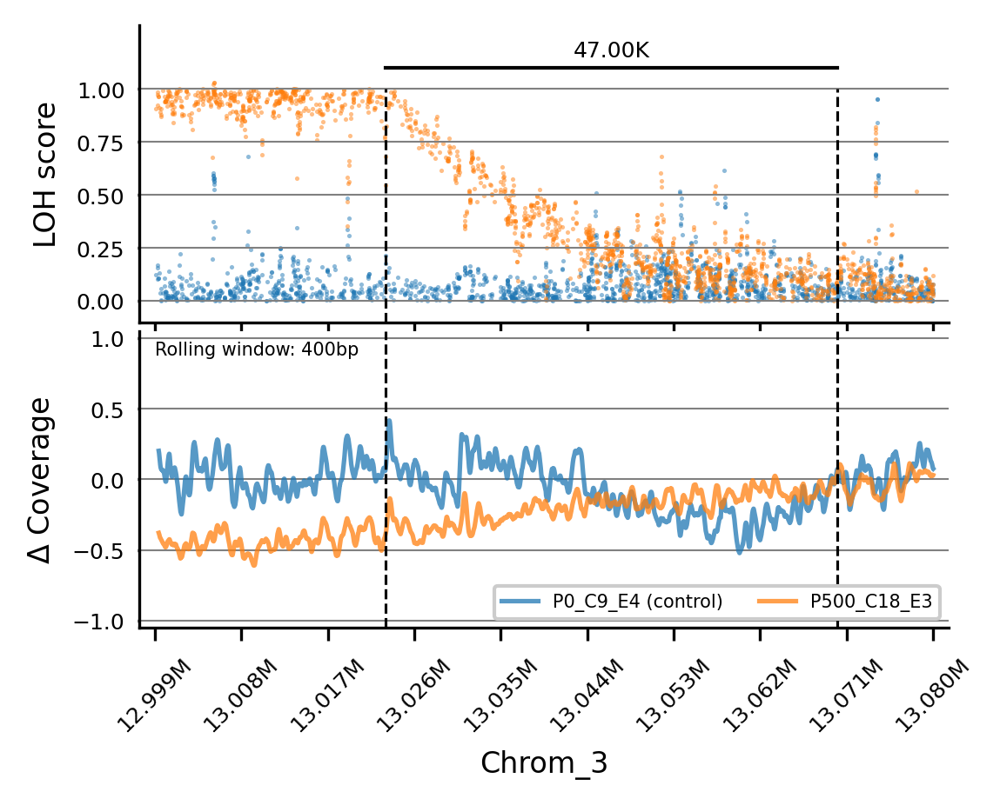

In [79]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 12999000, 13080000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=400, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 13023000, le = 13070000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

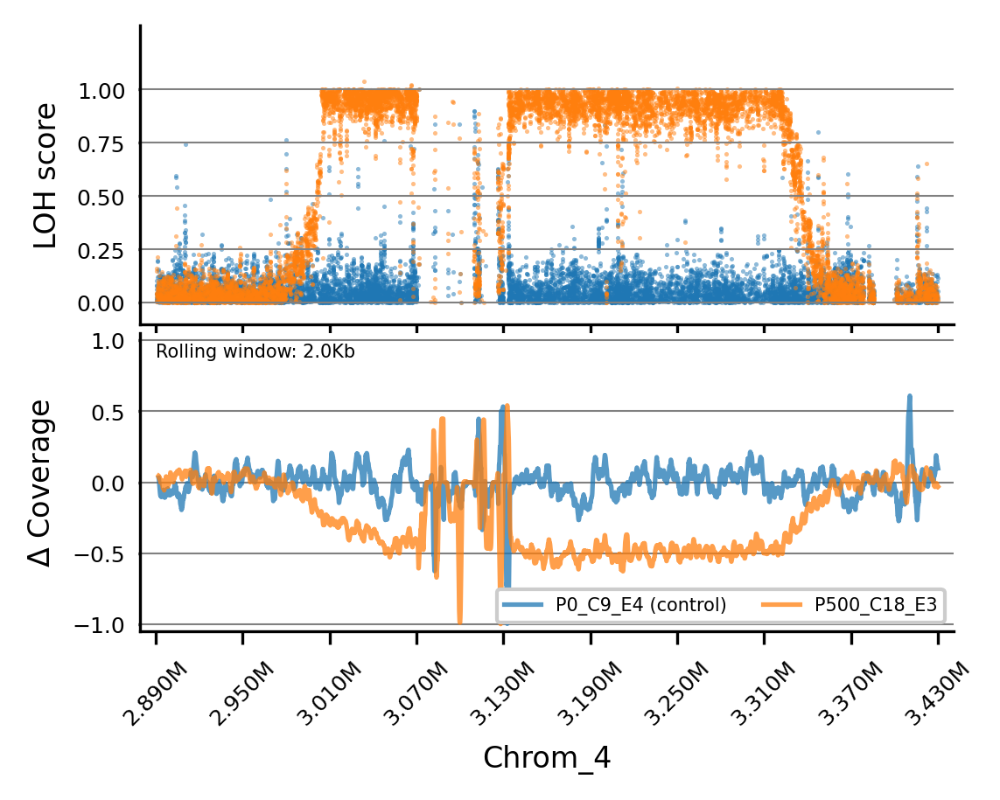

In [80]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 2890000, 3430000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 13023000, le = 13070000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

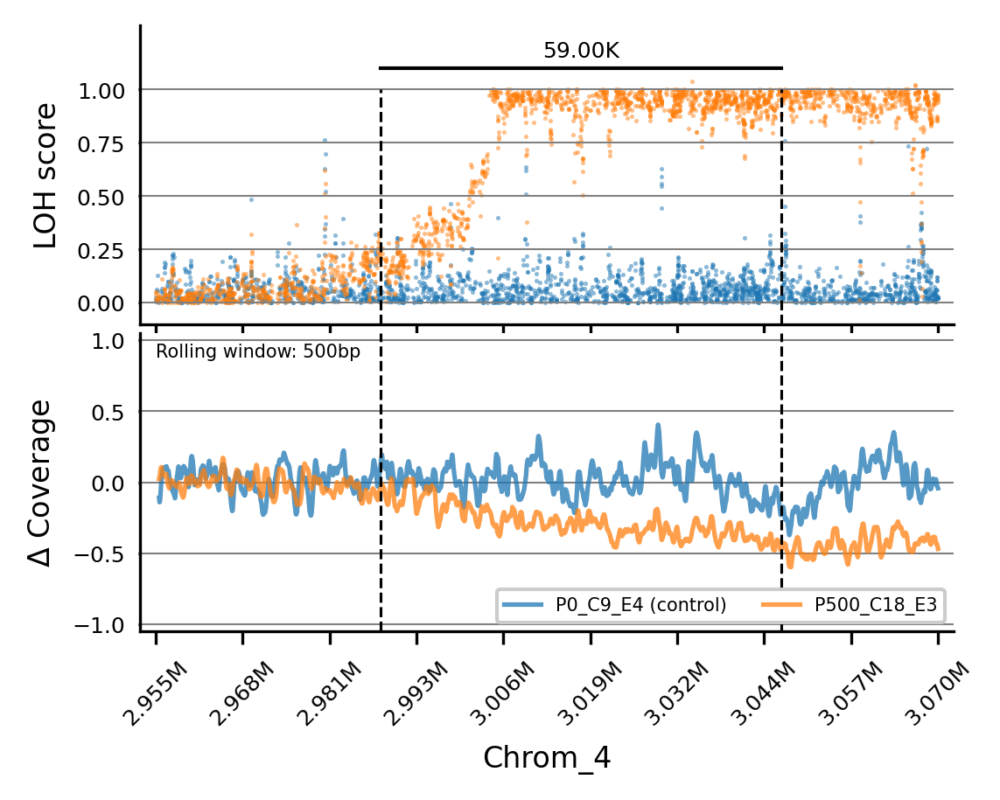

In [81]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 2955000, 3070000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=500, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 2988000, le = 3047000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

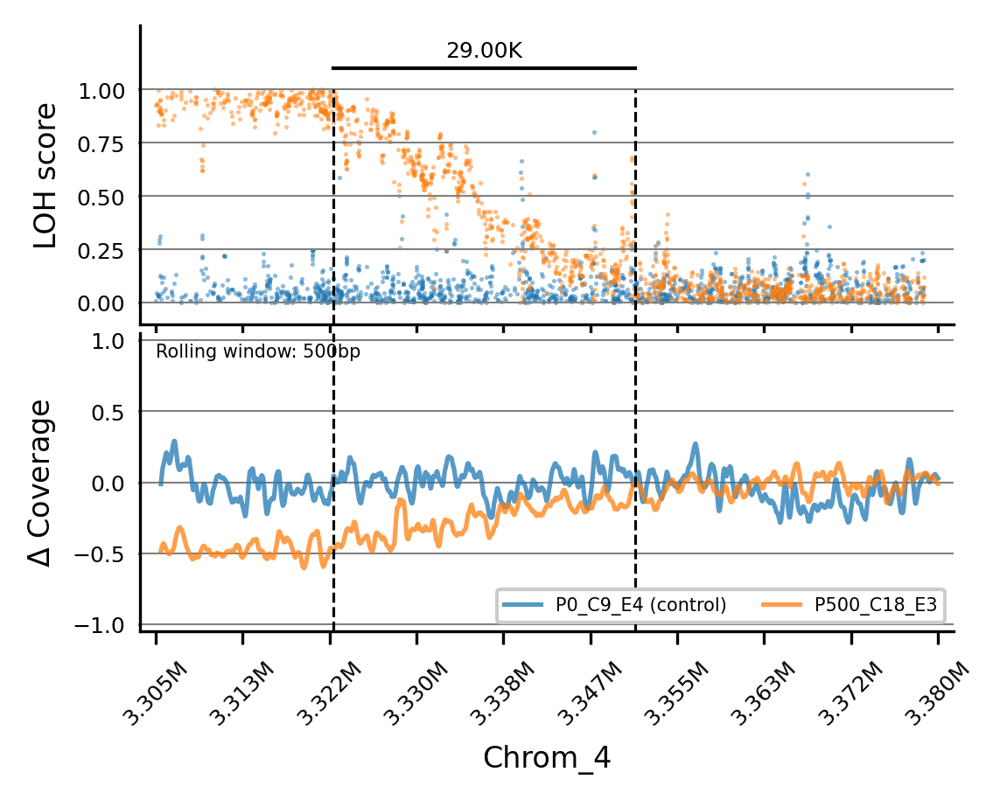

In [82]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 3305000, 3380000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=500, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 3322000, le = 3351000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

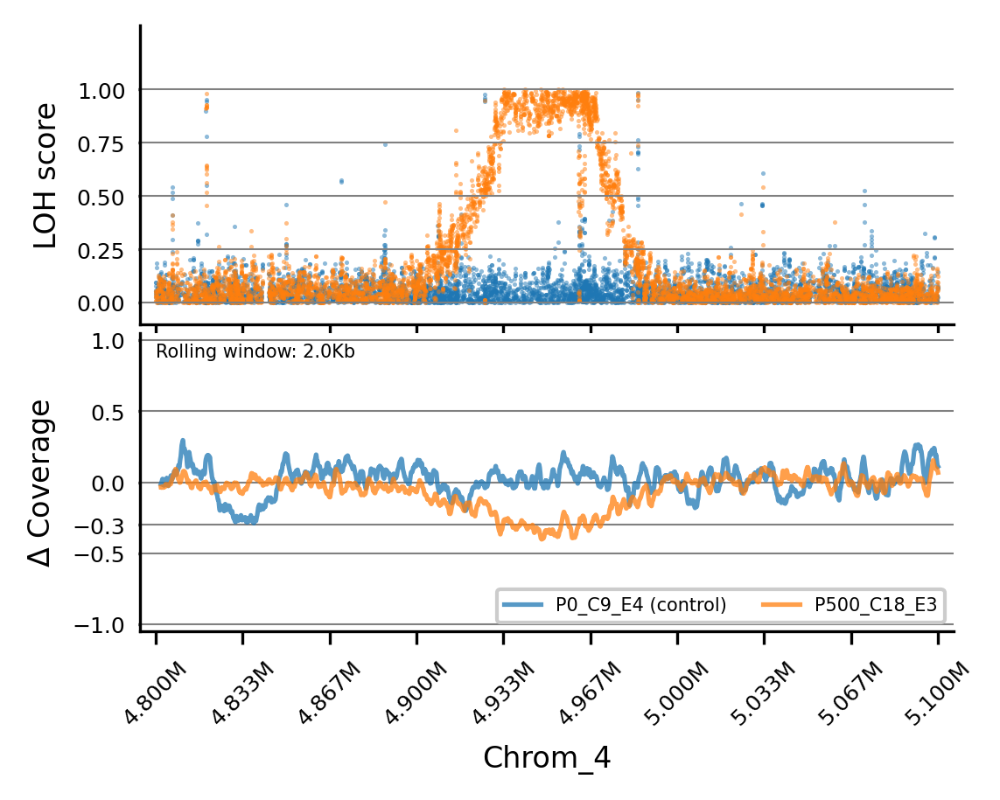

In [83]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 4800000, 5100000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.3, 0.0, 0.5, 1.0],
    #ls = 4901000, le = 4938000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

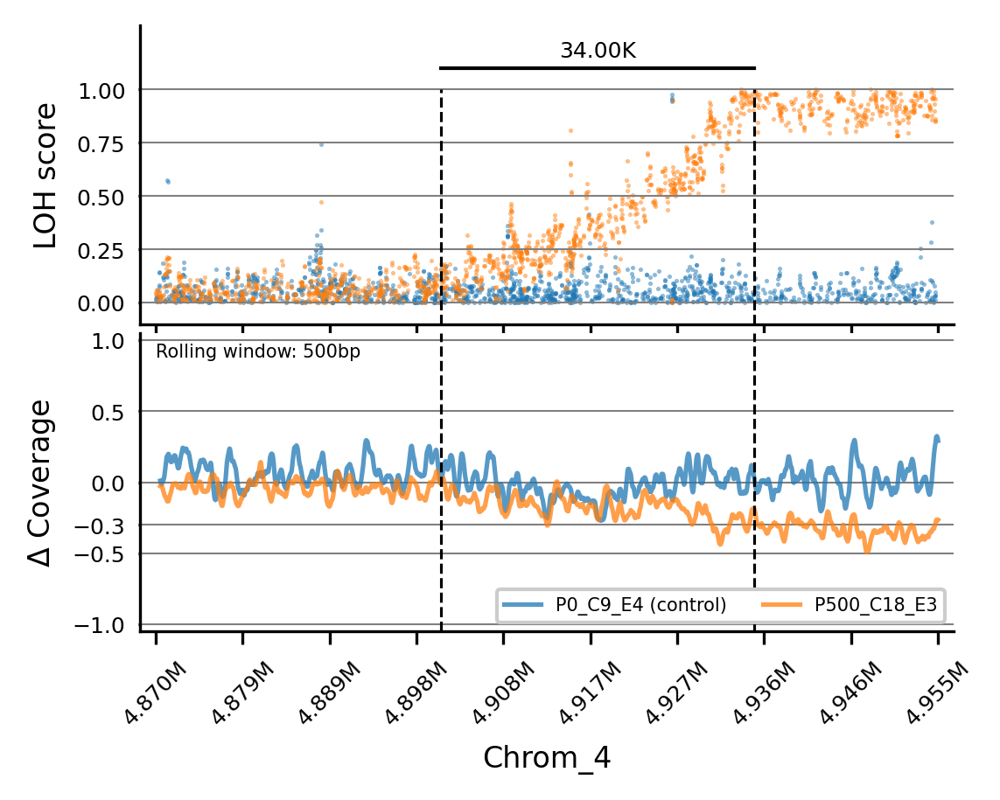

In [84]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 4870000, 4955000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=500, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.3, 0.0, 0.5, 1.0],
    ls = 4901000, le = 4935000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

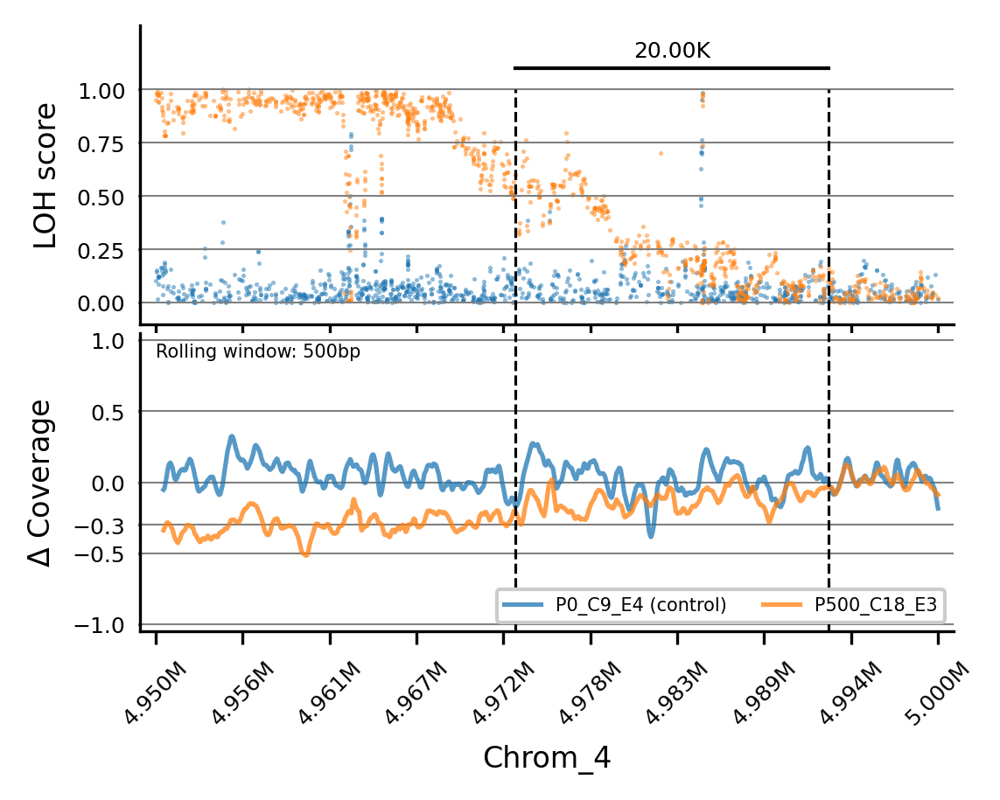

In [85]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_4", 4950000, 5000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=500, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.3, 0.0, 0.5, 1.0],
    ls = 4973000, le = 4993000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

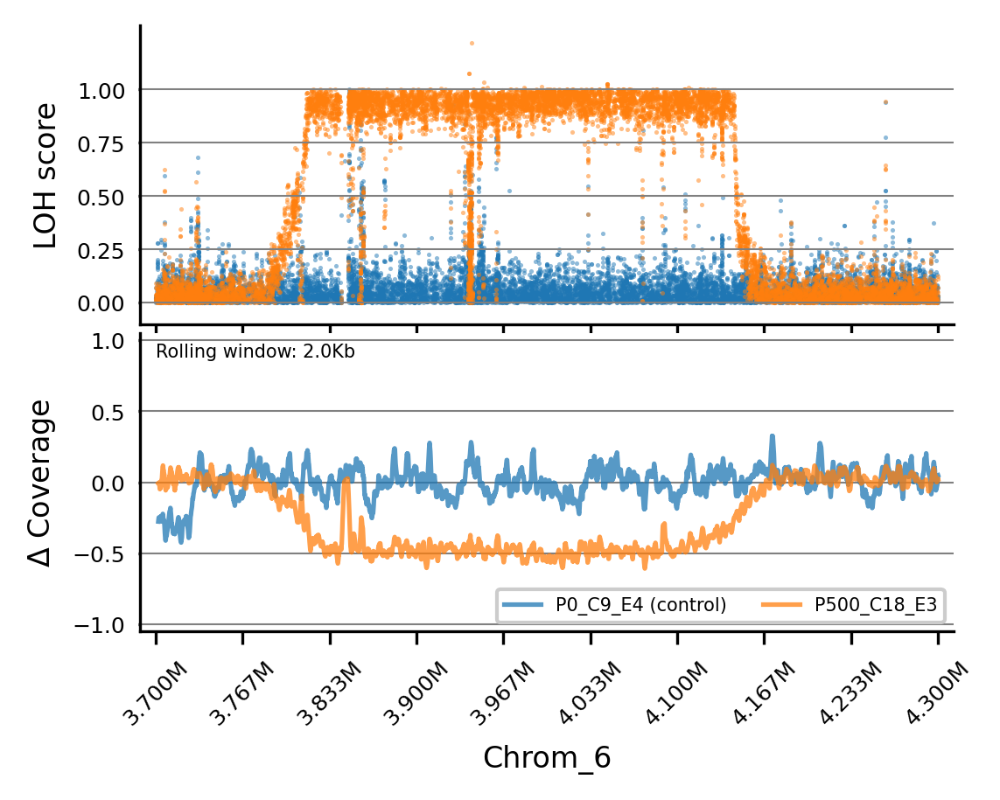

In [86]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 3700000, 4300000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 4965000, le = 4995000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

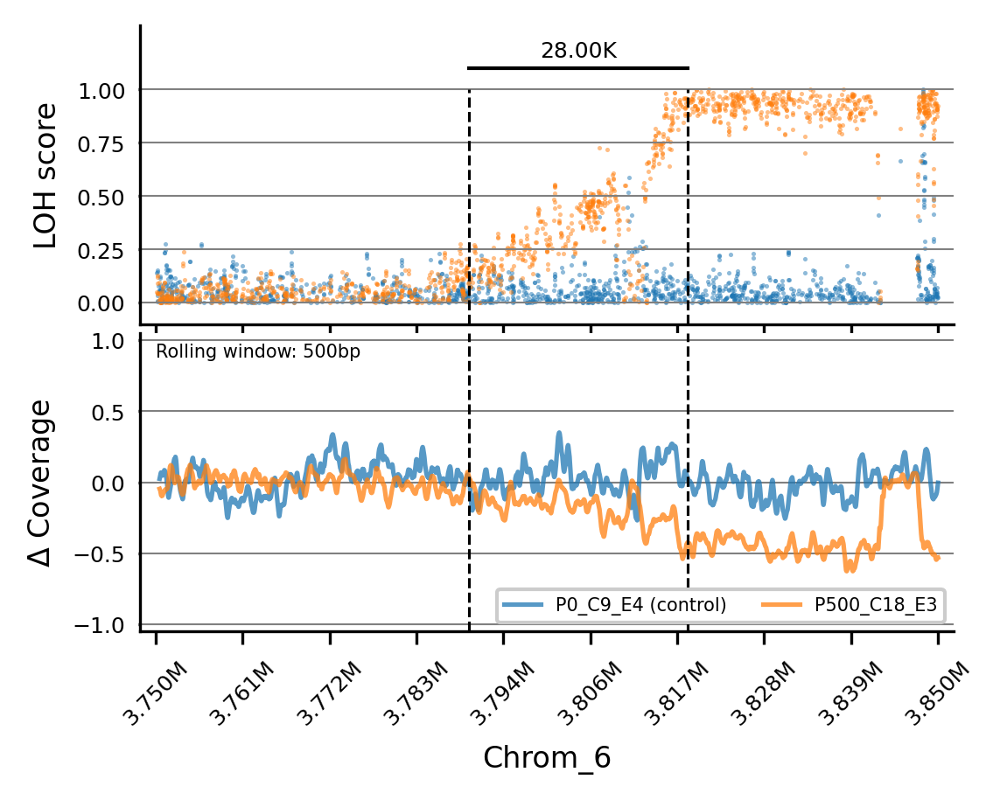

In [87]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 3750000, 3850000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=500, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 3790000, le = 3818000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

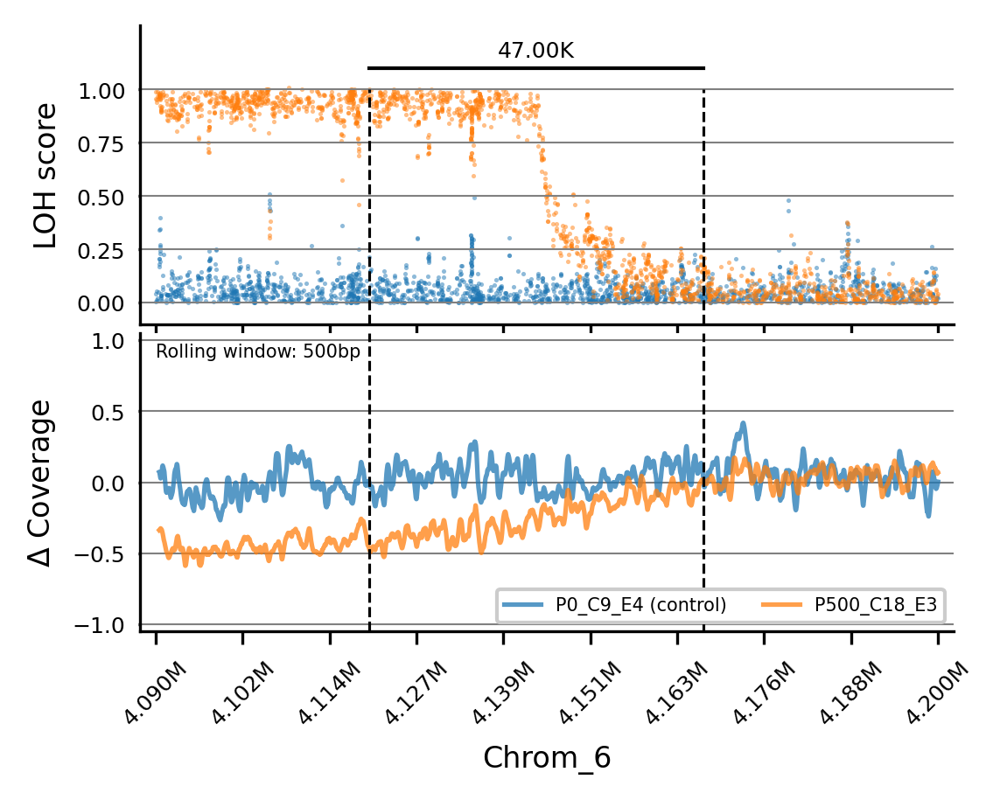

In [88]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 4090000, 4200000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=500, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 4120000, le = 4167000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

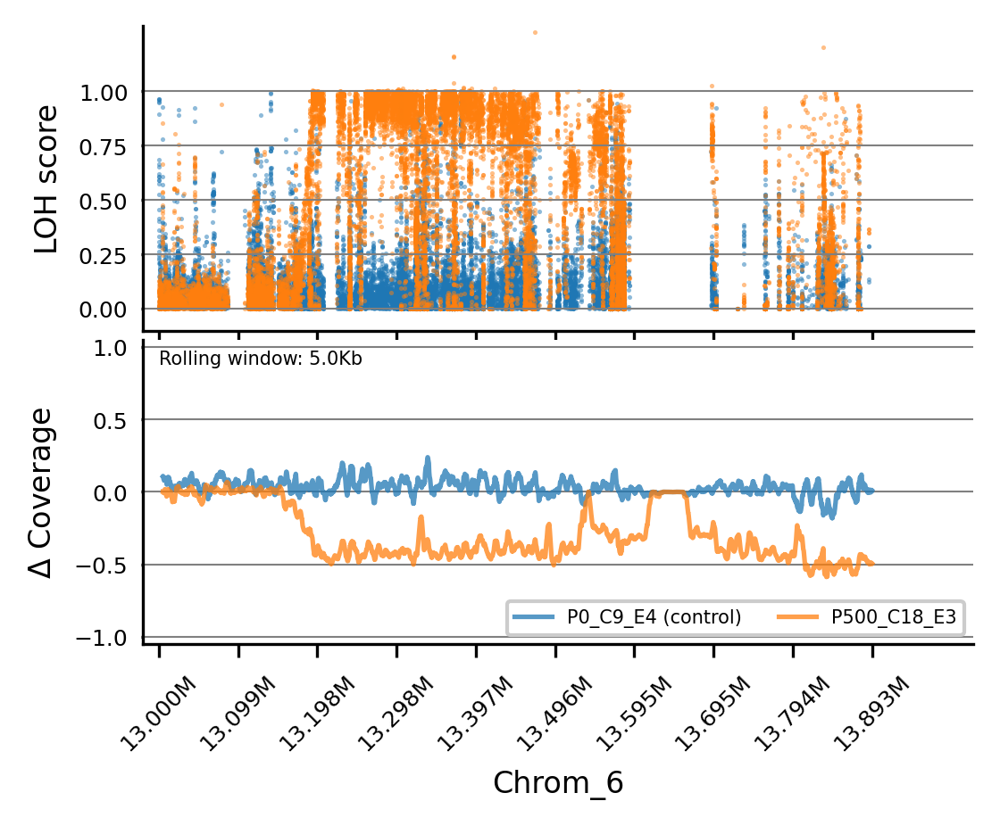

In [89]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 13000000, 14000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 4120000, le = 4167000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

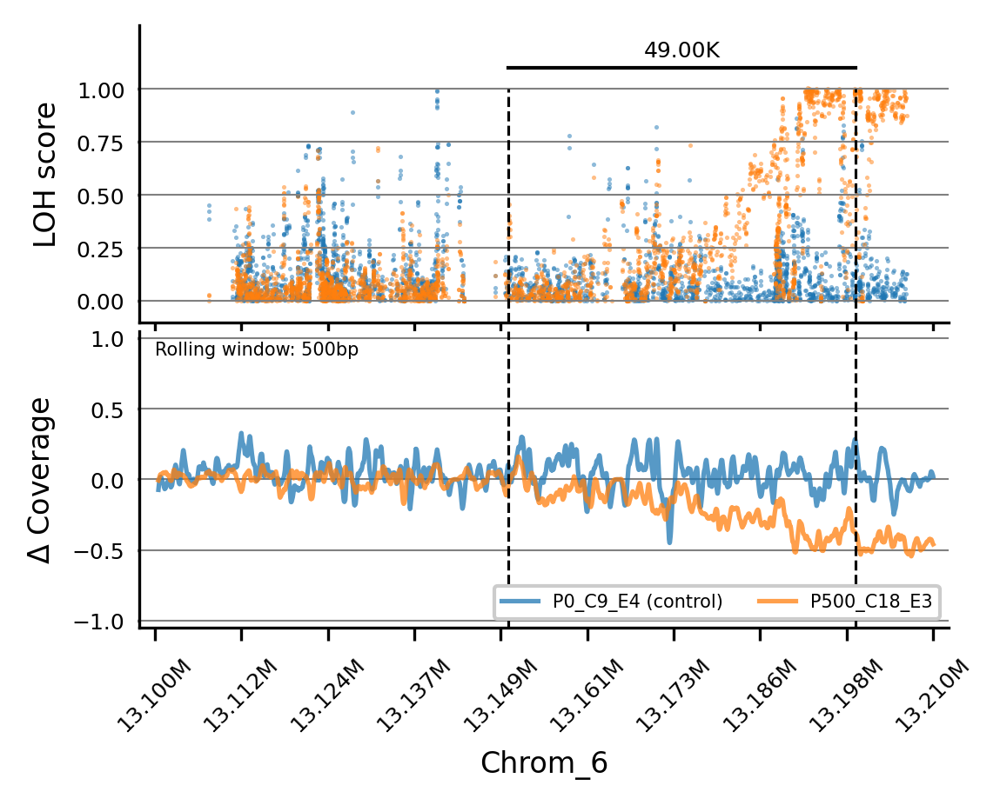

In [90]:
plot_region(
    "P500_C18_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_6", 13100000, 13210000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=500, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 13150000, le = 13199000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

# P500_C30_E3

In [91]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("P500_C30_E3", "P0_C9_E4", cov_data, vcf_GR)

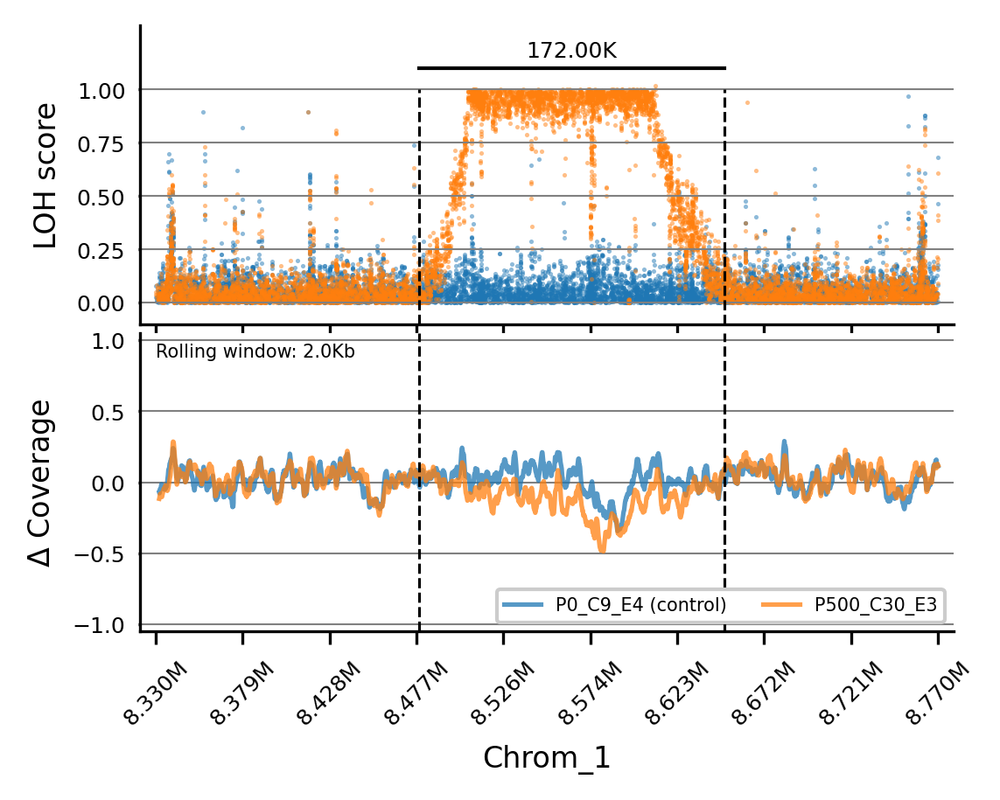

In [92]:
plot_region(
    "P500_C30_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 8330000, 8770000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 8478000, le = 8650000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

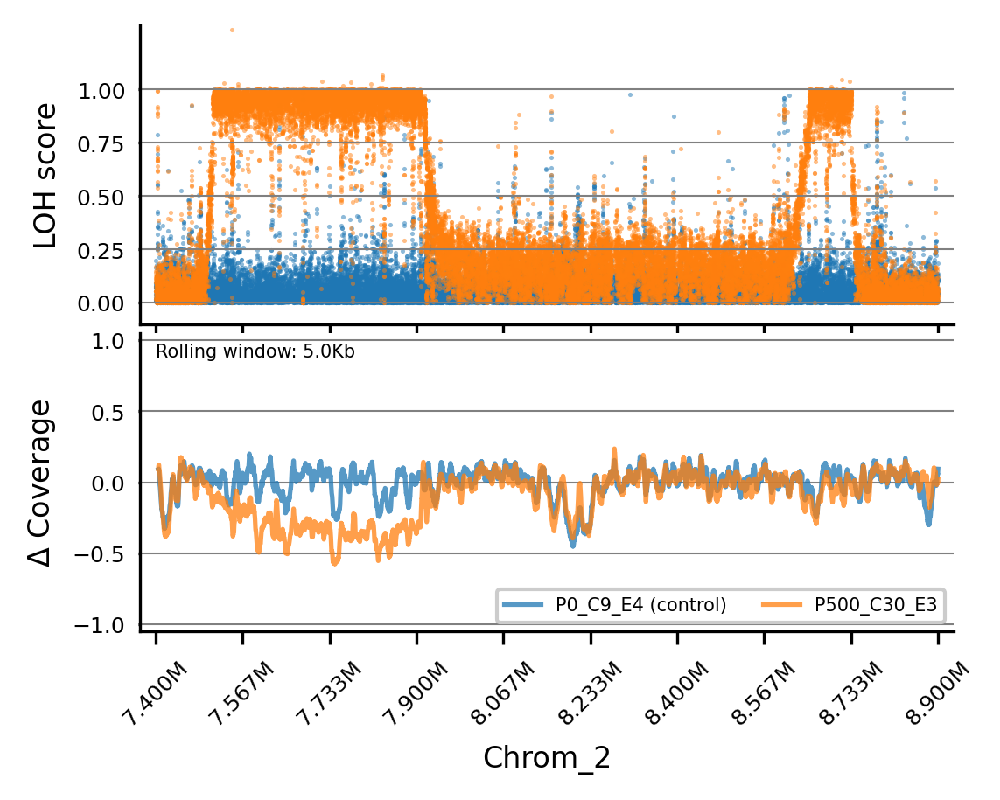

In [93]:
plot_region(
    "P500_C30_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_2", 7400000, 8900000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    #ls = 4039750, le = 4040250, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

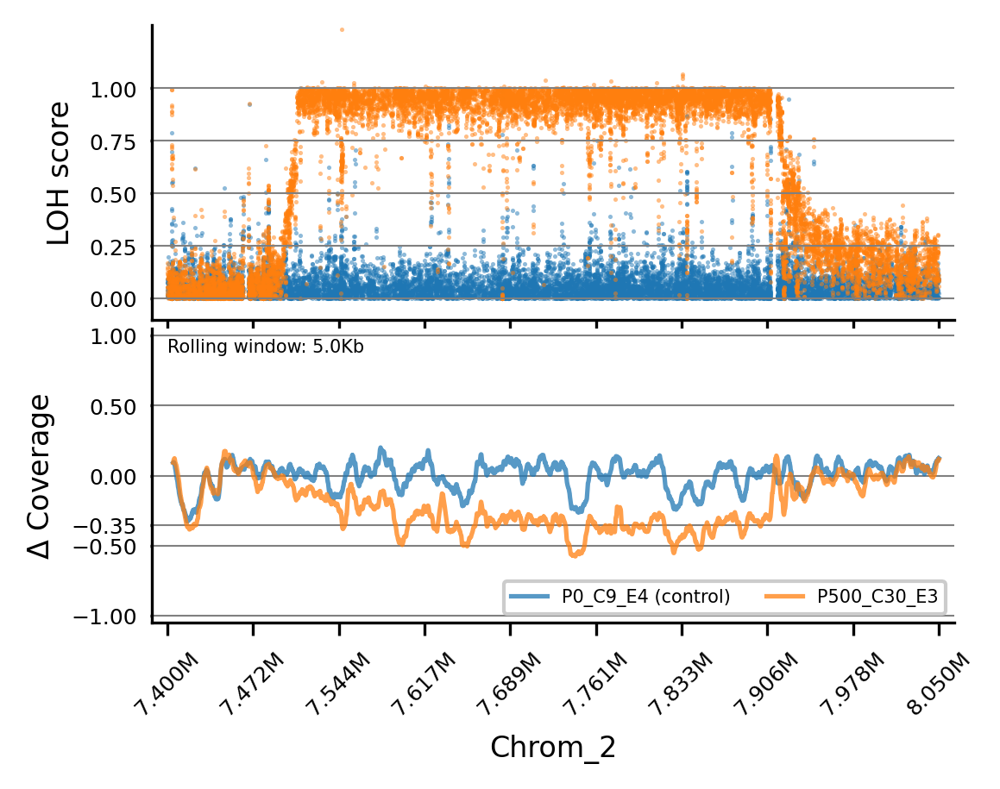

In [94]:
plot_region(
    "P500_C30_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_2", 7400000, 8050000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=5000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.35, 0.0, 0.5, 1.0],
    #ls = 4039750, le = 4040250, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

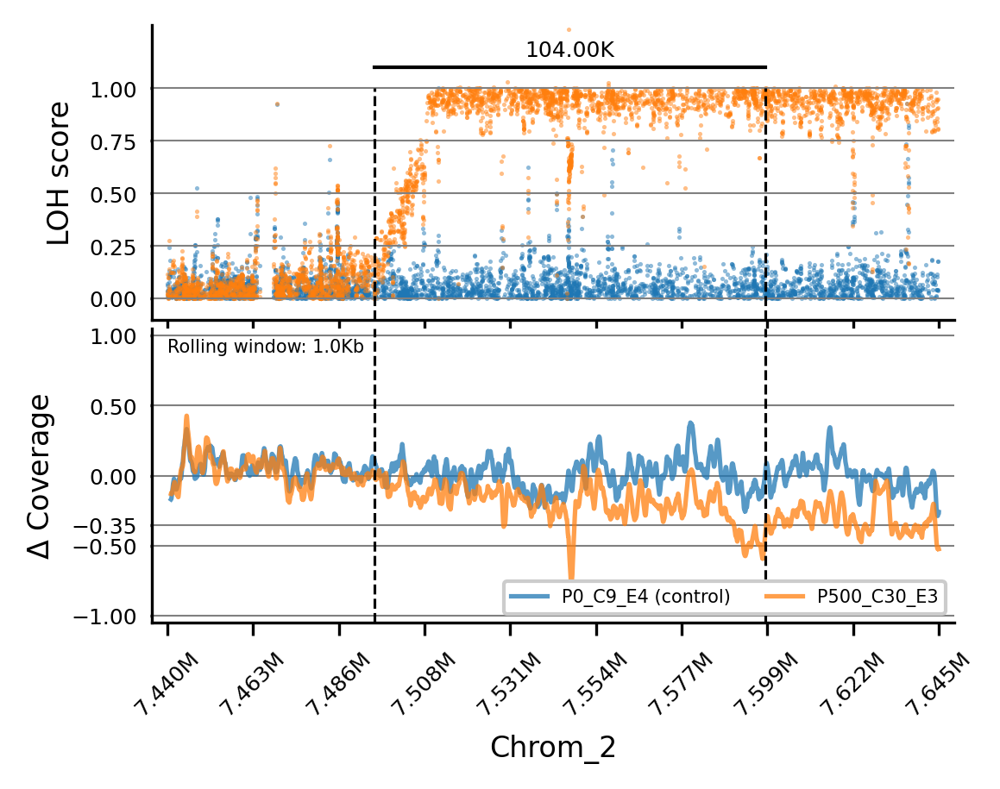

In [95]:
plot_region(
    "P500_C30_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_2", 7440000, 7645000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=1000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.35, 0.0, 0.5, 1.0],
    ls = 7495000, le = 7599000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

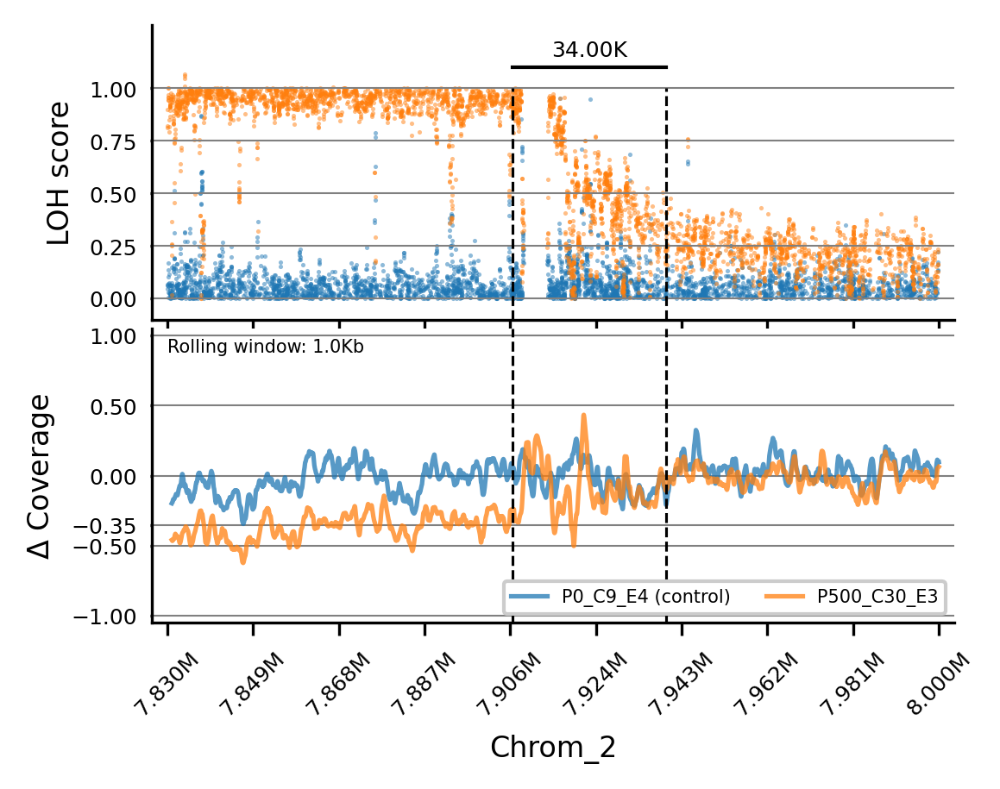

In [96]:
plot_region(
    "P500_C30_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_2", 7830000, 8000000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=1000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.35, 0.0, 0.5, 1.0],
    ls = 7906000, le = 7940000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

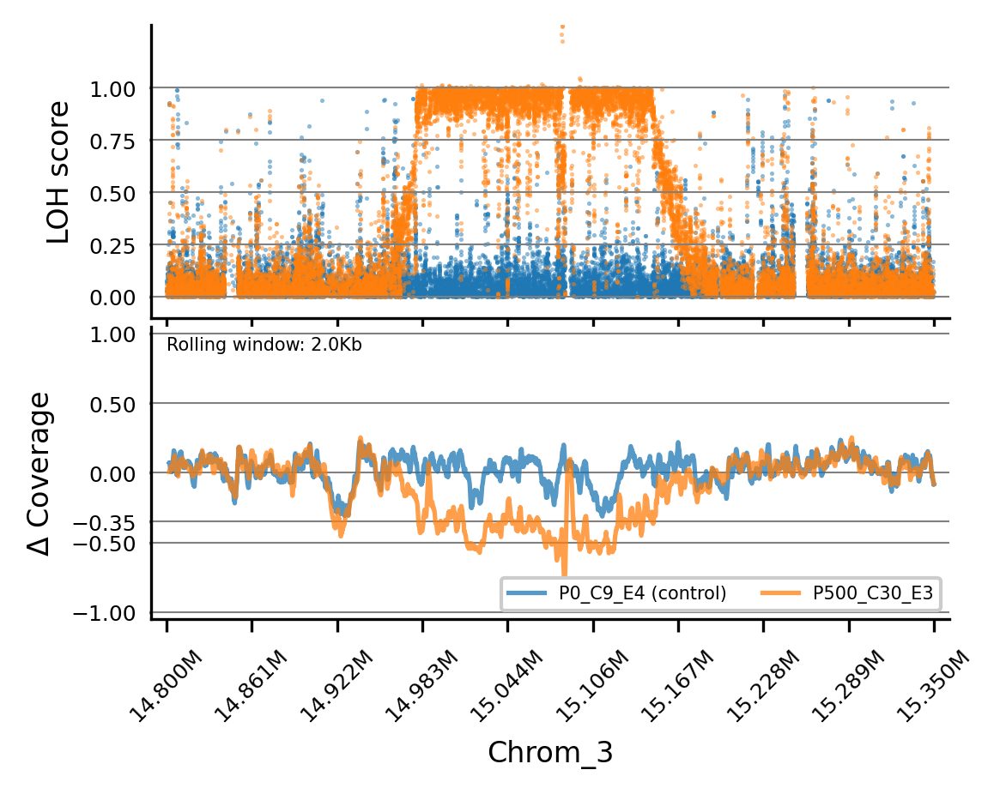

In [97]:
plot_region(
    "P500_C30_E3", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_3", 14800000, 15350000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, -0.35, 0.0, 0.5, 1.0],
    #ls = 7906000, le = 7940000, # line starts and line ends, yl = line y value
    #add_vlines = True,
)

# GR Repaired Deletions in P500 C16 E4 (Chrom 1)

In [107]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("P500_C16_E4", "P0_C9_E4", cov_data, vcf_GR)

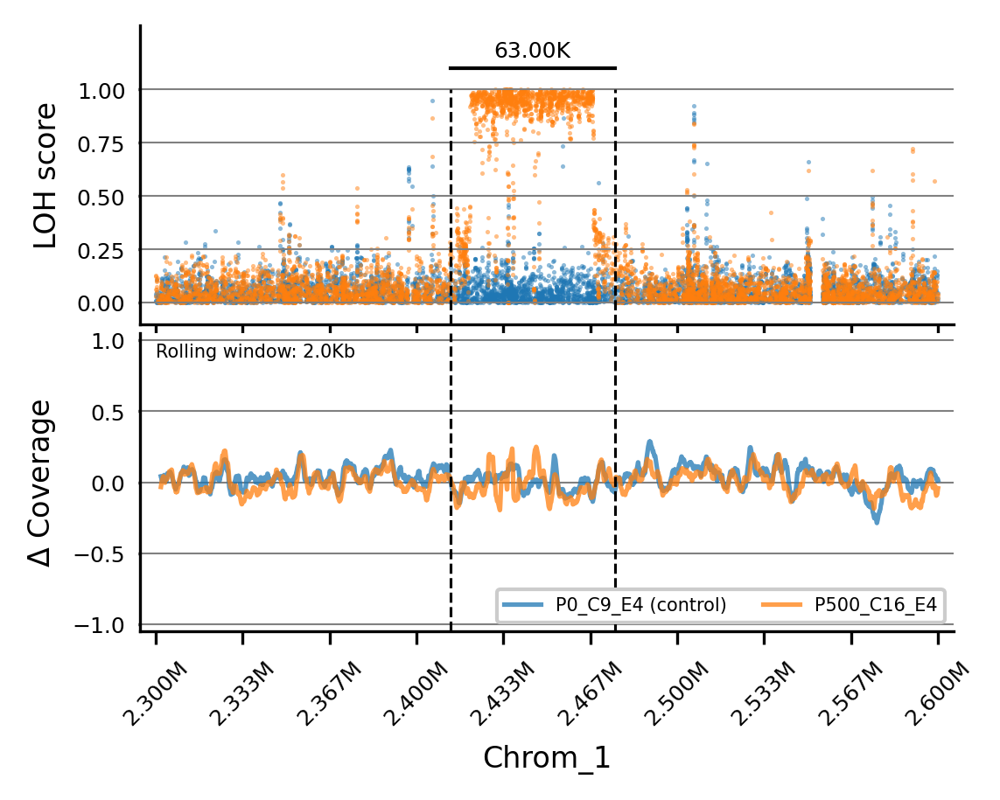

In [110]:
plot_region(
    "P500_C16_E4", "P0_C9_E4", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_1", 2300000, 2600000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 2413000, le = 2476000, # line starts and line ends, yl = line y value
    add_vlines = True,
)

# GR Repaired Deletions in P250 C17 E4 (Chrom 2)

In [111]:
df_end, cov_end, df_ctl, cov_ctl, df_mid, cov_mid = get_sample_data("P250_C17_E4", "P0_C27_E5", cov_data, vcf_GR)

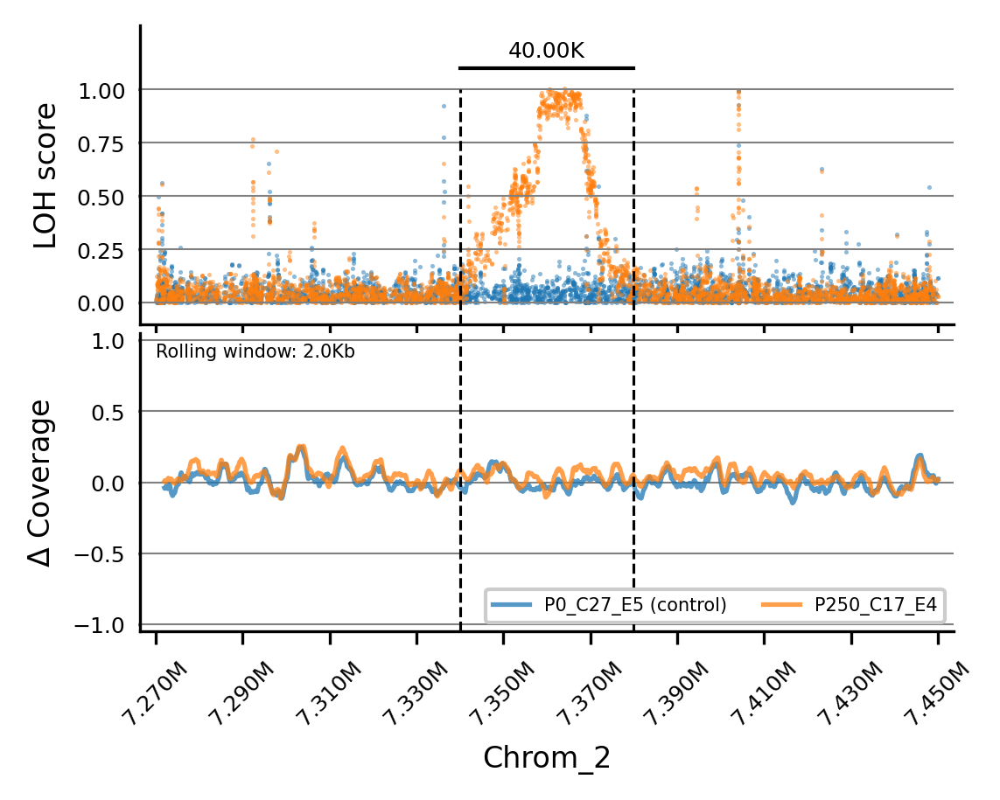

In [112]:
plot_region(
    "P250_C17_E4", "P0_C27_E5", # sample infos
    df_end, df_ctl, # snps data
    cov_end, cov_ctl, cov_anc, median_coverage, # coverage data
    "Chrom_2", 7270000, 7450000, # coordinates
    df_mid=df_mid, cov_mid=cov_mid, # in case of midpoint sample
    win_cov=2000, # smoothing for coverage
    cymin = -1.05, cymax = 1.05, # coverage ymin coverage ymax
    cyticks=[-1.0, -0.5, 0.0, 0.5, 1.0],
    ls = 7340000, le = 7380000, # line starts and line ends, yl = line y value
    add_vlines = True,
)